# Project Title Here

**Names**: Group member names here

You can delete and add as many code blocks as you like or change the formatting.

## 1. Introduction

Air quality is a parameter that refers to the condition of the air in a specific geographical area. Very fine particles can remain suspended in the air for extended periods. These particles, in the context of air quality, are typically pollutants present in the atmosphere and can significantly impact human health and the dynamics of ecosystems. The Air Quality Index (AQI) is a standardized metric created by government agencies to inform the public about the level of pollutants.

This project offers a comprehensive overview of recorded AQI values across different states in the U.S. from 1980 to 2022. This information can be used to analyze several aspects. First, it enables an understanding of how the clustering structure of air quality reporting for different states changes over time. Second, it assesses the effectiveness of environmental policies in specific regions, determining whether these policies are sufficient to improve air quality after their implementation by evaluating the total number of days throughout the year with healthy or unhealthy AQI. This analysis can be beneficial for the public in making informed decisions about places to live and assist government agencies in implementing policies that can help improve air quality.


Citations
1. https://www.cdc.gov/air/default.htm
2. https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7816214/
3. https://www.sciencedirect.com/science/article/abs/pii/S2214785320352342

In [ ]:
!pip install scikit-learn-extra

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 32.4 MB/s eta 0:00:00


In [ ]:
!pip install gower

In [ ]:
!pip install kmodes

In [76]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random
%matplotlib inline
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score, silhouette_samples, silhouette_score
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import StandardScaler
from sklearn_extra.cluster import KMedoids
from sklearn.manifold import TSNE
from gower import gower_matrix
from scipy.spatial.distance import pdist, squareform
from sklearn.manifold import TSNE
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score, calinski_harabasz_score
from sklearn.cluster import SpectralClustering,  KMeans
from sklearn.manifold import TSNE, SpectralEmbedding

from sklearn.cluster import KMeans, MiniBatchKMeans, Birch
from sklearn.datasets import make_blobs


from scipy.cluster.hierarchy import linkage, dendrogram
from sklearn.cluster import AgglomerativeClustering

from kmodes.kprototypes import KPrototypes

from gower import gower_matrix
from sklearn import preprocessing

## 2. Dataset Discussion

The current dataset has the recorded county level Air Quality Index by State from 1980 to 2022. This dataset is available on kaggle (https://www.kaggle.com/datasets/adampq/air-quality-index-by-state-1980-2022/data) (Downloaded on December 5th 2023). The original dataset, contains 2193 rows, each row corresponds to the report in Air Quality Index submitted by each state over 42 years (From 1980 to 2022). This dataset summarizes the total number of days through the year that fell under a specific category, for example the total number of day  that had an unhelthy AQI, that had CO as the main polutant, and so on. This dataset does not provide pollutant concentrations. Variables that can contribute to this report but that were not tabulated could be, total number of days of rain, total number of days with wildfires, the average yearly concentration of pollutants, to mention a few. Even when these variables were not included, their absence would not affect significantly the understanding how AQI reporting changes over a period of 20 years

#### Variables to use
- pop_est / Population Estimate per state per year
- TTL_Cnty / Total Counties per state per year
- Cnty_Rpt / Number of Counties Reporting
- Dys_w_AQI / Sum Number of Days with Air Quality Index measured,
- Dys_NM / Sum Number of Days Not Measured (Calculated)
- Dys_Abv_Thr / Sum Number of Days above threshold (Moderated)
- Dys_Blw_Thr / Sum Number of Days below threshold (Moderated)
- Good Days / Sum Number of Good Days
- Moderate Days / Sum Number of Moderate Days
- Unhealthy for Sensitive Groups Days / Sum Number of Unhealthy for Sensitive Groups Days
- Unhealthy Days / Sum Number of Unhealthy Days
- Very Unhealthy Days / Sum Number of Very Unhealthy Days
- Hazardous Days / Sum Number of Hazardous Days
- Max AQI / Sum Max Air Quality Index
- 90th Percentile AQI
- Median AQI
- Days CO / Sum Number of Days CO was main pollutant
- Days NO2 / Sum Number of Days NO2 was main pollutant
- Days Ozone / Sum Number of Days Ozone was main pollutant
- Days PM2.5 / Sum Number of Days Particulate Matter with diameter of 2.5 micrometers or smaller was main pollutant
- Days PM10 / Sum Number of Days Particulate Matter with a diameter of 10 micrometers or smaller was main pollutant

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving AQI By State 1980-2022.csv to AQI By State 1980-2022.csv


In [ ]:
df = pd.read_csv('AQI By State 1980-2022.csv')
df.head()


,Geo_Loc,Year,State,Pop_Est,TTL_Cnty,Cnty_Rpt,Dys_w_AQI,Dys_NM,Dys_Blw_Thr,Dys_Abv_Thr,...,Very Unhealthy Days,Hazardous Days,Max AQI,90th Percentile AQI,Median AQI,Days CO,Days NO2,Days Ozone,Days PM2.5,Days PM10
0,POINT (-86.63186076199969 32.84057112200048),1980,Alabama,3900368,67,7,1382,1180,1169,213,...,8,0,1282,774,314,240,334,808,0,0
1,POINT (-147.72205903599973 64.84507995700051),1980,Alaska,405315,30,4,1184,280,1099,85,...,16,0,586,306,132,732,121,331,0,0
2,POINT (-111.76381127699972 34.865970280000454),1980,Arizona,2737774,15,7,1866,696,1561,305,...,7,0,1078,678,355,721,151,994,0,0
3,POINT (-92.27449074299966 34.74865012400045),1980,Arkansas,2288738,75,1,366,0,320,46,...,1,0,202,115,38,0,29,337,0,0
4,POINT (-120.99999953799971 37.63864012300047),1980,California,23800800,58,41,13728,1278,11221,2507,...,725,4,7869,4771,2215,1763,3685,8280,0,0


## 3. Dataset Cleaning and Exploration

#### Missing Values

There are no missing values in the dataframe

In [ ]:
nan_count = df.isna().sum()
print(nan_count)

Geo_Loc                                0
Year                                   0
State                                  0
Pop_Est                                0
TTL_Cnty                               0
Cnty_Rpt                               0
Dys_w_AQI                              0
Dys_NM                                 0
Dys_Blw_Thr                            0
Dys_Abv_Thr                            0
Good Days                              0
Moderate Days                          0
Unhealthy for Sensitive Groups Days    0
Unhealthy Days                         0
Very Unhealthy Days                    0
Hazardous Days                         0
Max AQI                                0
90th Percentile AQI                    0
Median AQI                             0
Days CO                                0
Days NO2                               0
Days Ozone                             0
Days PM2.5                             0
Days PM10                              0
dtype: int64


#### Outlier Identification

##### Two Variables
Observation of the pair plot, puts in evidence the presence of very few outliers. For example, there is an observation with very high values for the total number of days that were considered hazardous and maybe the same observation is the one that shows high values for the total number of days where CO was the main polutant. Other than that, there are no more visible outliers

##### Three Variables
Observation of the dendogram obtained by using single linkage puts in evidence that there are no outliers in the dataset.

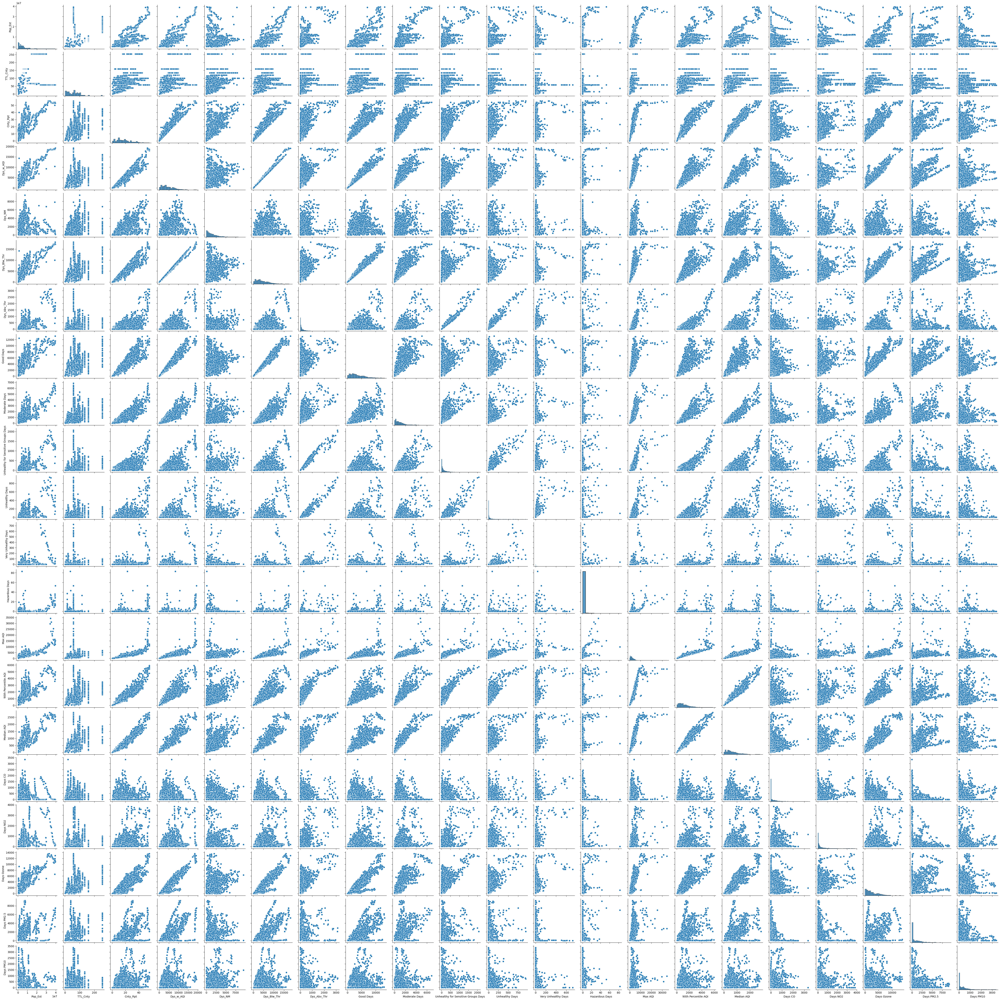

In [ ]:
## Numerical Variables
dfnum = df.iloc[:,3:31]
sns.pairplot(dfnum)

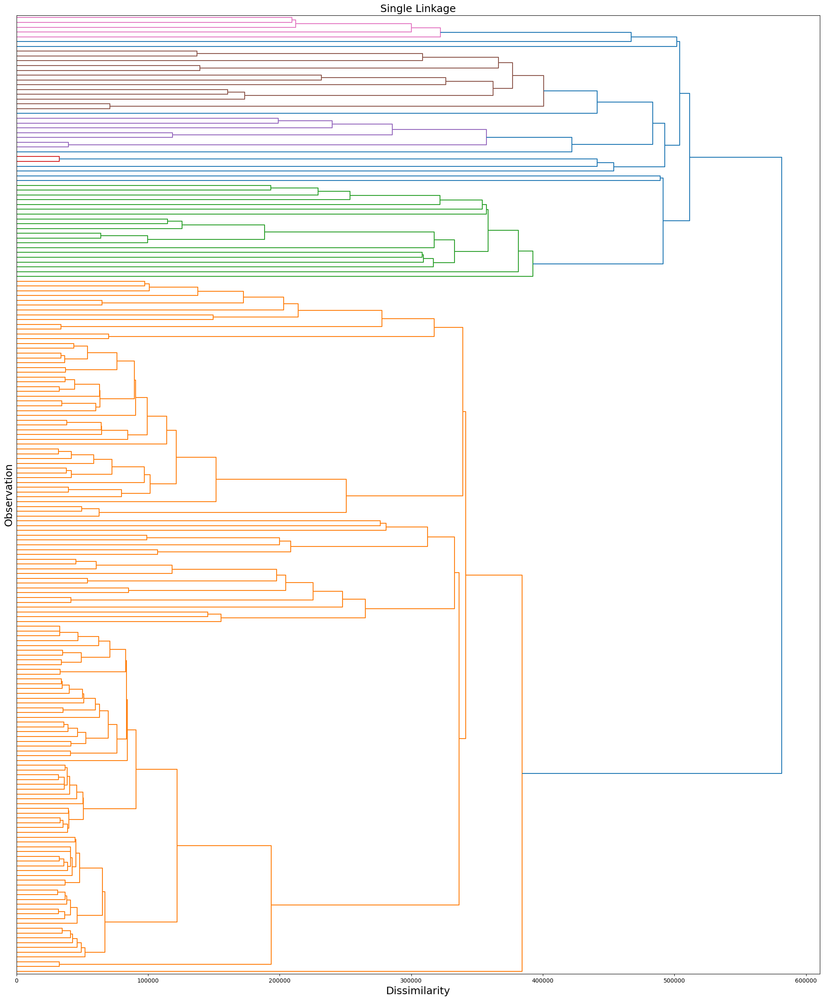

In [ ]:
## Three Variables, Single linkage, Hierarchical Clustering
dm = pdist(dfnum, metric = 'euclidean')
link = linkage(dm, method = 'single')
fig, ax = plt.subplots(figsize = (25,30))
d = dendrogram(link, orientation = 'right', ax = ax, truncate_mode = 'lastp', p = 200, no_labels = True)
ax.set_xlabel('Dissimilarity', fontsize = 18)
ax.set_ylabel('Observation', fontsize = 18)
plt.yticks(fontsize = 12)
plt.title('Single Linkage', fontsize = 18)
plt.show()

#### Noise Consideration and Identification

For noise identification: Calculate the nearest neighbor (2 to 10) to each observation and ploted the distance obtained for each observation. It is possible to observe that the data does not have any significant noise, the higher values for distance are not very high.

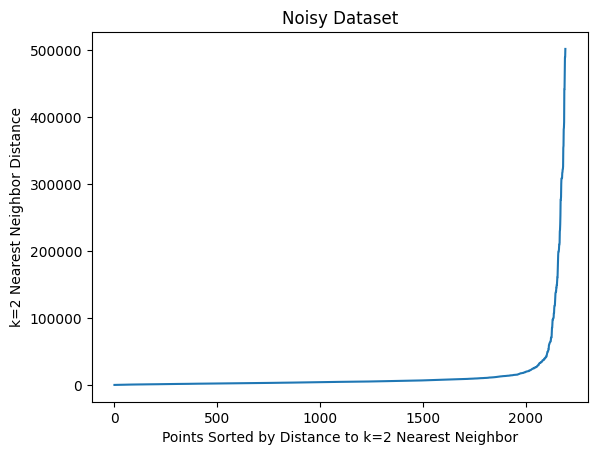

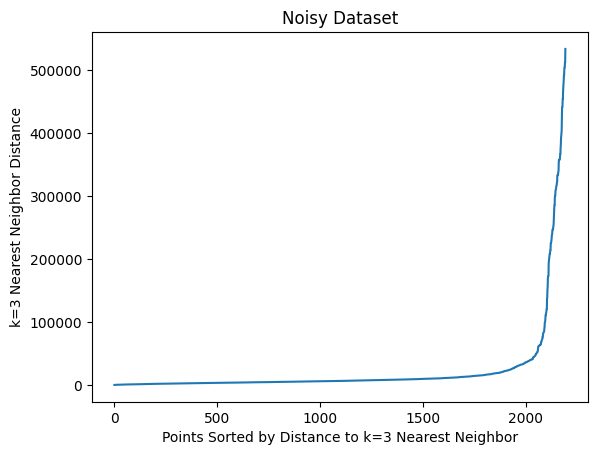

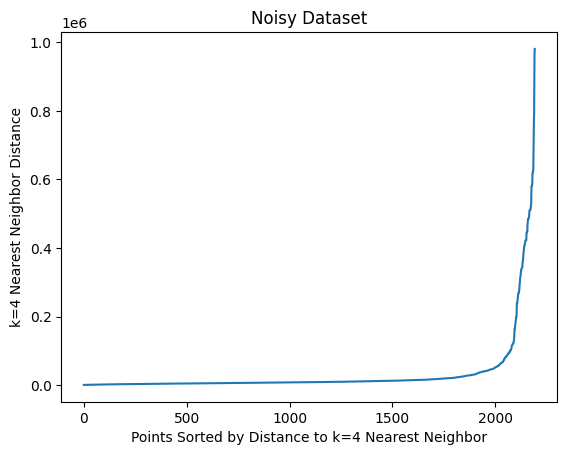

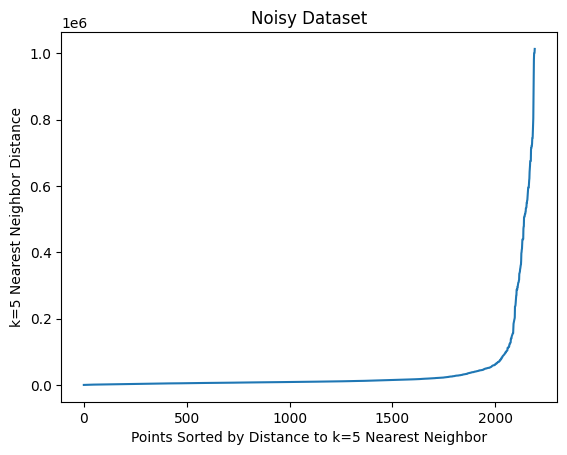

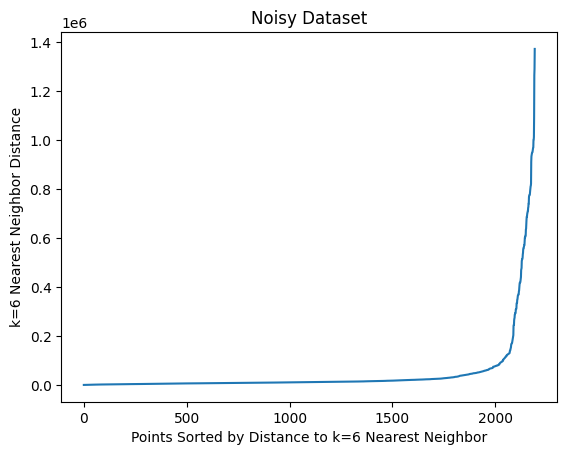

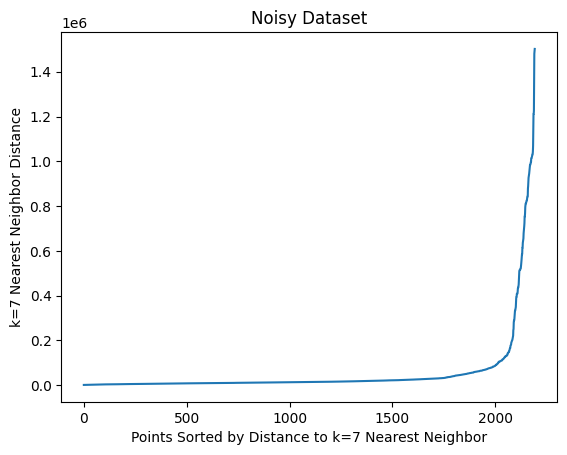

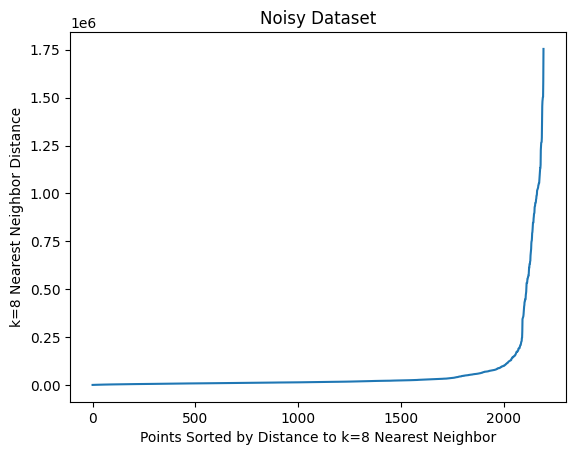

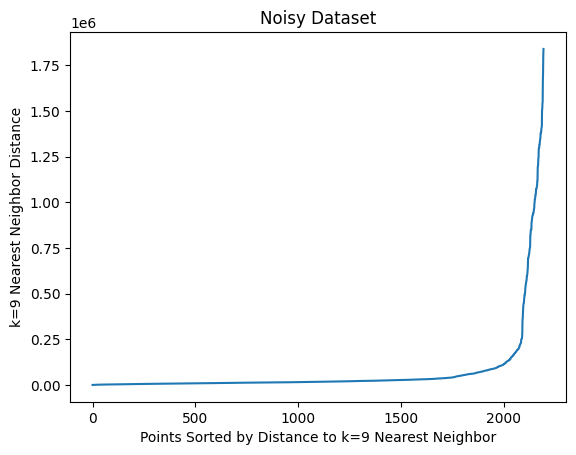

In [ ]:
for k in range(2,10):
  nbrs = NearestNeighbors(n_neighbors=k, algorithm='ball_tree').fit(dfnum)
  distances, indices = nbrs.kneighbors(dfnum)

  plt.plot(np.sort(distances.T[k-1]))
  plt.xlabel('Points Sorted by Distance to k=%s Nearest Neighbor'%k)
  plt.ylabel('k=%s Nearest Neighbor Distance'%k)
  plt.title('Noisy Dataset')
  plt.show()

#### Outlier and Noise Consideration

Given that there were no outliers properly identified there is no need to have considerations about them. Even though, in case that there were outliers, let's say a state that in a specific year did very poor at reporting AQI data, it would be reasonable to exclude that state or find a way to provide information about that year by using the information obtained in the next or previous 2 or 3 years, this is important to consider, given that it can impact the conclusions that can be derive for a clustering analysis. For example, the state improved in its AQI or got worse when in reality that would not be the scenario

The data is not noisy at all. Similarly, in the case that there was noise, it is important to first understand the source of that noise. Lets assume that instead of report by states, the dataframe provides reports by a number of counties per state throughout the years. This type of data, can be a source of noise that can lead to poor or misleading clustering structures depending on the algorythm used. Therefore if the noise is mild, it would be reasonable to exclude those observations, given that for example a countryside county can very likely fail in providing AQI reports consistenly throughout the year creating some noise

#### Other Data Cleaning

Given that the goal is to understand changes in the clustering structure over time, the original data frame got split in two, one data frame that has reports from 1980 to 2000 and another data frame that has reports from 2000 to 2022

In [ ]:
## Before 2000
df1 = df[df['Year'] <= 2000]
dfnum1 = df1.iloc[:,3:31]

## After 2000
df2 = df[df['Year'] > 2000]
dfnum2 = df2.iloc[:,3:31]

## 4. Basic Descriptive Analysis

In [ ]:
## Before 2000 NUMERICAL
dfnum1.describe()


,Pop_Est,TTL_Cnty,Cnty_Rpt,Dys_w_AQI,Dys_NM,Dys_Blw_Thr,Dys_Abv_Thr,Good Days,Moderate Days,Unhealthy for Sensitive Groups Days,...,Very Unhealthy Days,Hazardous Days,Max AQI,90th Percentile AQI,Median AQI,Days CO,Days NO2,Days Ozone,Days PM2.5,Days PM10
count,1.071000e+03,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,...,1071.000000,1071.00000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.00000,1071.000000
mean,4.946008e+06,61.647059,14.892624,3785.342670,1654.723623,3503.737628,281.605042,2730.863679,772.873950,197.188609,...,18.812325,0.22409,2196.734827,1144.150327,546.129785,434.588235,511.316527,2291.016807,127.90943,420.511671
std,5.417769e+06,46.340154,11.332966,3135.360405,1590.245955,2799.172065,417.683825,2161.372307,734.911878,259.693856,...,66.488572,1.62694,2058.445154,1037.013321,477.432727,448.815679,704.887347,2268.266762,408.51435,564.298355
min,4.053150e+05,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000
25%,1.225267e+06,23.000000,6.000000,1439.000000,454.000000,1345.000000,41.000000,1059.500000,240.000000,30.000000,...,0.000000,0.00000,756.500000,409.000000,214.000000,94.500000,55.000000,619.500000,0.00000,5.000000
50%,3.324144e+06,62.000000,12.000000,3049.000000,1189.000000,2813.000000,139.000000,2170.000000,608.000000,105.000000,...,3.000000,0.00000,1639.000000,819.000000,417.000000,307.000000,260.000000,1500.000000,0.00000,242.000000
75%,5.796466e+06,88.000000,21.000000,5456.000000,2375.000000,4913.500000,384.500000,3881.000000,1087.000000,275.000000,...,10.500000,0.00000,3151.500000,1605.500000,767.500000,623.000000,698.000000,3306.000000,48.00000,613.000000
max,3.398798e+07,254.000000,56.000000,18582.000000,9504.000000,16150.000000,3115.000000,12344.000000,4989.000000,2067.000000,...,725.000000,33.00000,29602.000000,5938.000000,2838.000000,3339.000000,3837.000000,13642.000000,3428.00000,3363.000000


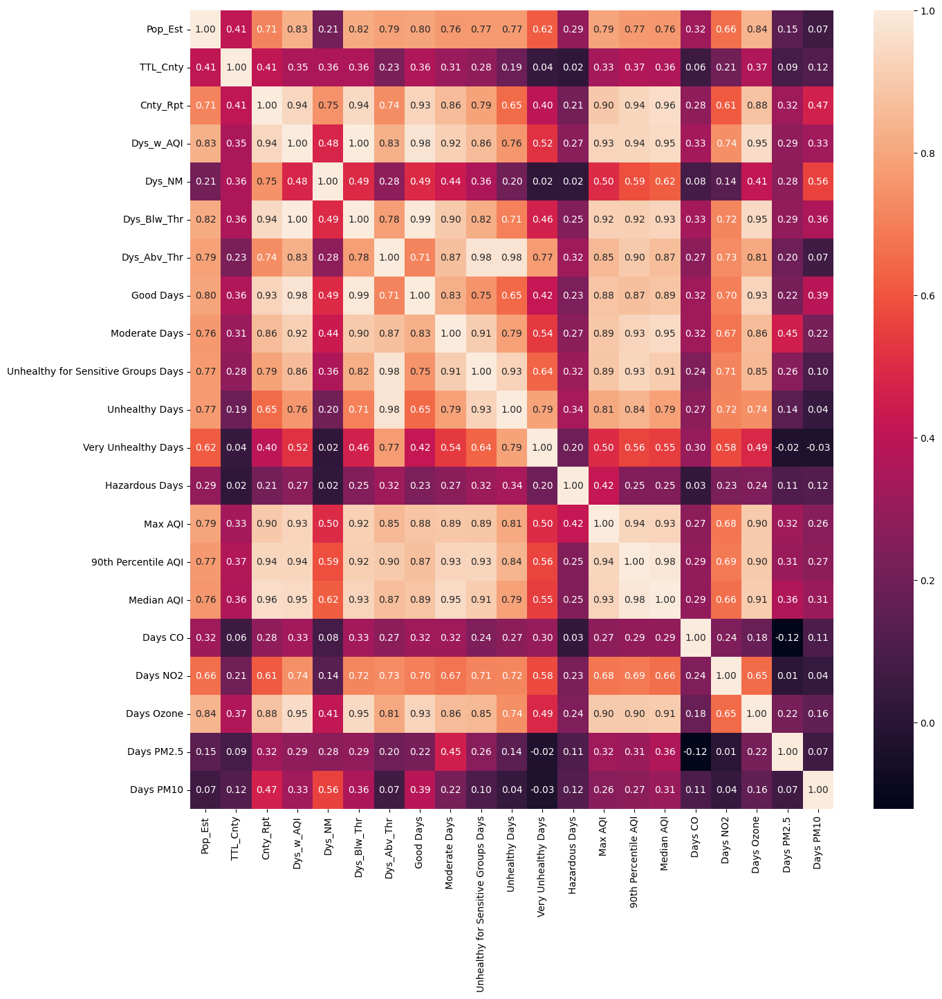

In [ ]:
## Before 2000 Correlation Matrix
matrix1 = dfnum1.corr()

plt.figure(figsize=(15, 15))
sns.heatmap(matrix1, annot=True, fmt=".2f")
plt.show()

In [ ]:
## Before 2000 CATEGORICAL
dfcat1 = df1.iloc[:,0:3]
dfcat1['Year'] = dfcat1['Year'].astype('object')
print(dfcat1.describe())

categorical = dfcat1.columns

for i in categorical:
    print(i)
    print(dfcat1[i].value_counts())
    print('--------')

                                             Geo_Loc  Year    State
count                                           1071  1071     1071
unique                                            51    21       51
top     POINT (-86.63186076199969 32.84057112200048)  1980  Alabama
freq                                              21    51       21
Geo_Loc
POINT (-86.63186076199969 32.84057112200048)      21
POINT (-77.86070029399963 40.79373015200048)      21
POINT (-117.07184056399967 39.493240390000494)    21
POINT (-71.50036091999965 43.65595011300047)      21
POINT (-74.27369128799967 40.13057004800049)      21
POINT (-106.24058098499967 34.52088095200048)     21
POINT (-75.54397042699964 42.82700103200045)      21
POINT (-79.15925046299964 35.466220975000454)     21
POINT (-100.11842104899966 47.47531977900047)     21
POINT (-82.40426005599966 40.06021014100048)      21
POINT (-97.52107021399968 35.47203135600046)      21
POINT (-120.15503132599969 44.56744942400047)     21
POINT (-71.52247

In [ ]:
## After 2000
dfnum2.describe()

,Pop_Est,TTL_Cnty,Cnty_Rpt,Dys_w_AQI,Dys_NM,Dys_Blw_Thr,Dys_Abv_Thr,Good Days,Moderate Days,Unhealthy for Sensitive Groups Days,...,Very Unhealthy Days,Hazardous Days,Max AQI,90th Percentile AQI,Median AQI,Days CO,Days NO2,Days Ozone,Days PM2.5,Days PM10
count,1.122000e+03,1122.000000,1122.000000,1122.000000,1122.000000,1122.000000,1122.000000,1122.000000,1122.000000,1122.000000,...,1122.000000,1122.000000,1122.000000,1122.000000,1122.000000,1122.000000,1122.000000,1122.000000,1122.000000,1122.000000
mean,6.082839e+06,61.647059,20.462567,5967.803922,1505.661319,5809.007130,158.796791,4482.409982,1326.597148,128.845811,...,2.861854,0.875223,2711.803922,1318.595365,777.251337,43.545455,172.946524,3342.084670,2104.144385,305.082888
std,6.863923e+06,46.339170,12.151179,3852.550754,1374.099515,3679.605193,313.216944,2794.716134,1137.359282,229.598405,...,12.231399,4.787410,2749.762542,961.758759,536.581683,118.648899,310.295052,2573.010066,1816.116943,435.272937
min,1.791420e+05,1.000000,1.000000,178.000000,0.000000,178.000000,0.000000,103.000000,4.000000,0.000000,...,0.000000,0.000000,101.000000,53.000000,40.000000,0.000000,0.000000,57.000000,61.000000,0.000000
25%,1.617102e+06,23.000000,11.000000,3121.250000,481.500000,3044.000000,16.000000,2380.250000,457.500000,14.000000,...,0.000000,0.000000,1234.250000,601.250000,367.000000,0.000000,19.250000,1486.250000,718.000000,7.250000
50%,4.250548e+06,62.000000,19.000000,5173.000000,1143.000000,5055.000000,59.000000,3913.000000,1099.500000,51.500000,...,0.000000,0.000000,2166.000000,1104.000000,663.500000,2.000000,67.000000,2643.000000,1619.000000,135.500000
75%,6.978568e+06,88.000000,29.000000,8167.000000,2179.250000,7997.250000,166.000000,6143.750000,1739.750000,137.750000,...,1.000000,0.000000,3318.500000,1763.750000,1057.000000,17.000000,172.750000,4855.500000,2794.750000,430.000000
max,3.950165e+07,254.000000,55.000000,19255.000000,7999.000000,18192.000000,3123.000000,13139.000000,6865.000000,1991.000000,...,183.000000,83.000000,34234.000000,5617.000000,2781.000000,1059.000000,2153.000000,13208.000000,9184.000000,3132.000000


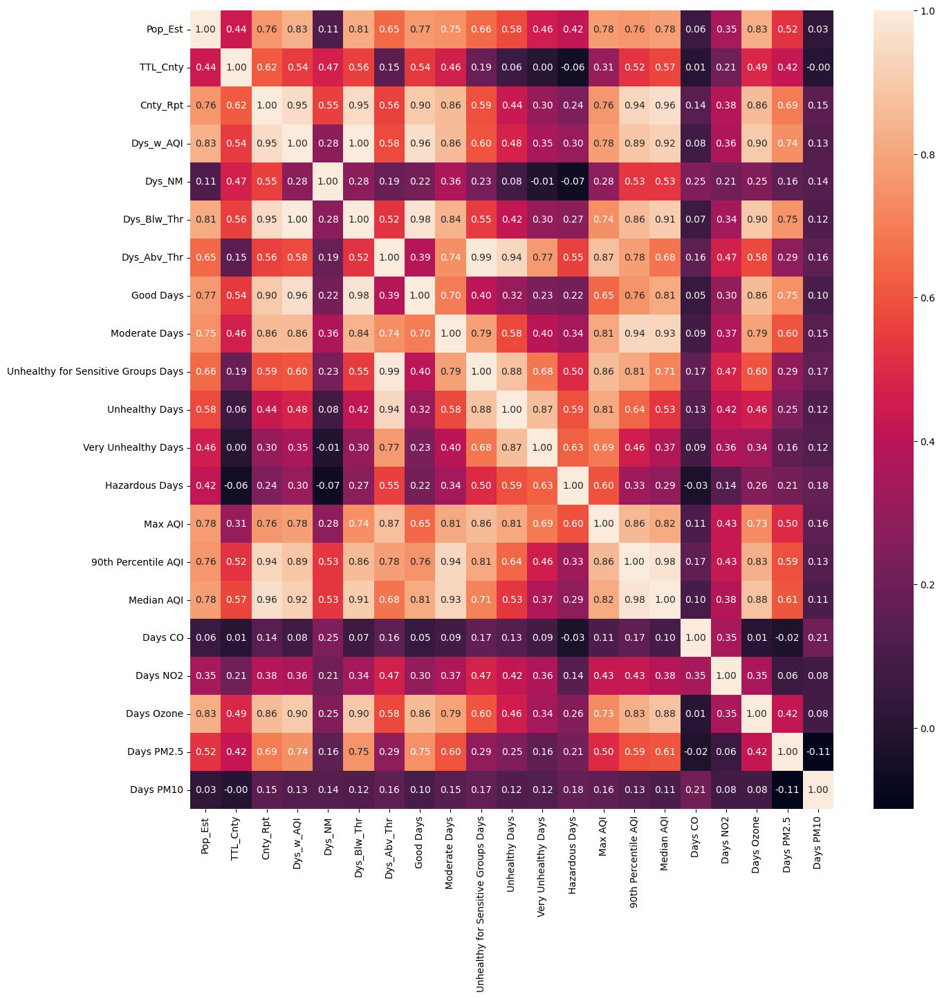

In [ ]:
matrix2 = dfnum2.corr()

plt.figure(figsize=(15, 15))
sns.heatmap(matrix2, annot=True, fmt=".2f")
plt.show()

In [ ]:
## After 2000 CATEGORICAL
dfcat2 = df2.iloc[:,0:3]
dfcat2['Year'] = dfcat2['Year'].astype('object')
print(dfcat2.describe())

categorical = dfcat2.columns

for i in categorical:
    print(i)
    print(dfcat2[i].value_counts())
    print('--------')

                                             Geo_Loc  Year    State
count                                           1122  1122     1122
unique                                            51    22       51
top     POINT (-86.63186076199969 32.84057112200048)  2001  Alabama
freq                                              22    51       22
Geo_Loc
POINT (-86.63186076199969 32.84057112200048)      22
POINT (-77.86070029399963 40.79373015200048)      22
POINT (-117.07184056399967 39.493240390000494)    22
POINT (-71.50036091999965 43.65595011300047)      22
POINT (-74.27369128799967 40.13057004800049)      22
POINT (-106.24058098499967 34.52088095200048)     22
POINT (-75.54397042699964 42.82700103200045)      22
POINT (-79.15925046299964 35.466220975000454)     22
POINT (-100.11842104899966 47.47531977900047)     22
POINT (-82.40426005599966 40.06021014100048)      22
POINT (-97.52107021399968 35.47203135600046)      22
POINT (-120.15503132599969 44.56744942400047)     22
POINT (-71.52247

### Pairwise Analysis

In general for there are observations highly correlated one with each other. Some of these correlations are logical. For example, there is a strong correlation between the total number of days that were above the moderate threshold with the total number of days that were considered unhealthy. The same situation occurs with days were ozone was the main polutant and good days or days below the threshold.

## 5. Scaling Decisions

The dataset should be scaled. This is due to the fact that there are variables like population that totally outweight the values obtained for total number of days. Given that we are doing comparisons between two groups of datasets we will scale each dataframe separately.

In [ ]:
### Before 2000
df1_numerical_scale = dfnum1.copy()

# Scaling
scaler = StandardScaler()
scaled = scaler.fit_transform(df1_numerical_scale)
df1_numerical_scale = pd.DataFrame(scaled, columns = df1_numerical_scale.columns, index = df1_numerical_scale.index)
df1_numerical_scale.describe().round(2)


,Pop_Est,TTL_Cnty,Cnty_Rpt,Dys_w_AQI,Dys_NM,Dys_Blw_Thr,Dys_Abv_Thr,Good Days,Moderate Days,Unhealthy for Sensitive Groups Days,...,Very Unhealthy Days,Hazardous Days,Max AQI,90th Percentile AQI,Median AQI,Days CO,Days NO2,Days Ozone,Days PM2.5,Days PM10
count,1071.00,1071.00,1071.00,1071.00,1071.00,1071.00,1071.00,1071.00,1071.00,1071.00,...,1071.00,1071.00,1071.00,1071.00,1071.00,1071.00,1071.00,1071.00,1071.00,1071.00
mean,-0.00,-0.00,-0.00,0.00,0.00,0.00,-0.00,0.00,0.00,0.00,...,-0.00,-0.00,0.00,0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-0.84,-1.31,-1.31,-1.21,-1.04,-1.25,-0.67,-1.26,-1.05,-0.76,...,-0.28,-0.14,-1.07,-1.10,-1.14,-0.97,-0.73,-1.01,-0.31,-0.75
25%,-0.69,-0.83,-0.79,-0.75,-0.76,-0.77,-0.58,-0.77,-0.73,-0.64,...,-0.28,-0.14,-0.70,-0.71,-0.70,-0.76,-0.65,-0.74,-0.31,-0.74
50%,-0.30,0.01,-0.26,-0.23,-0.29,-0.25,-0.34,-0.26,-0.22,-0.36,...,-0.24,-0.14,-0.27,-0.31,-0.27,-0.28,-0.36,-0.35,-0.31,-0.32
75%,0.16,0.57,0.54,0.53,0.45,0.50,0.25,0.53,0.43,0.30,...,-0.13,-0.14,0.46,0.45,0.46,0.42,0.26,0.45,-0.20,0.34
max,5.36,4.15,3.63,4.72,4.94,4.52,6.79,4.45,5.74,7.20,...,10.63,20.16,13.32,4.62,4.80,6.47,4.72,5.01,8.08,5.22


In [ ]:
df1_numerical_scale

,Pop_Est,TTL_Cnty,Cnty_Rpt,Dys_w_AQI,Dys_NM,Dys_Blw_Thr,Dys_Abv_Thr,Good Days,Moderate Days,Unhealthy for Sensitive Groups Days,...,Very Unhealthy Days,Hazardous Days,Max AQI,90th Percentile AQI,Median AQI,Days CO,Days NO2,Days Ozone,Days PM2.5,Days PM10
0,-0.193092,0.115568,-0.696756,-0.766886,-0.298662,-0.834471,-0.164328,-0.904415,-0.518500,-0.116301,...,-0.162695,-0.137801,-0.444589,-0.357106,-0.486431,-0.433762,-0.251671,-0.654116,-0.313255,-0.745542
1,-0.838503,-0.683249,-0.961594,-0.830067,-0.864876,-0.859490,-0.470923,-0.849331,-0.775794,-0.586305,...,-0.042318,-0.137801,-0.782866,-0.808612,-0.867815,0.662969,-0.553988,-0.864507,-0.313255,-0.745542
2,-0.407781,-1.007093,-0.696756,-0.612446,-0.603159,-0.694364,0.056037,-0.842851,-0.165912,0.253538,...,-0.177742,-0.137801,-0.543739,-0.449722,-0.400515,0.638448,-0.511408,-0.572077,-0.313255,-0.745542
3,-0.490702,0.288285,-1.226432,-1.091084,-1.041032,-1.137917,-0.564339,-1.141412,-0.977273,-0.651797,...,-0.268026,-0.137801,-0.969502,-0.992881,-1.064793,-0.968752,-0.684566,-0.861861,-0.313255,-0.745542
4,3.481803,-0.078739,2.304743,3.172618,-0.237007,2.758268,5.330431,2.333467,3.643126,3.743891,...,10.626151,2.321951,2.756894,3.499033,3.497142,2.961199,4.504502,2.641568,-0.313255,-0.745542
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1066,0.398839,1.562074,2.216464,1.633959,2.566384,1.786098,0.295565,1.495645,2.404303,0.681164,...,-0.268026,-0.137801,1.332339,1.623543,1.952748,-0.148434,1.455782,0.862287,4.952177,0.327087
1067,0.178109,-0.488942,0.715714,0.366208,1.151477,0.481175,-0.475713,0.548119,0.220709,-0.463025,...,-0.283073,-0.137801,0.098793,0.112732,0.297291,0.292934,-0.691663,-0.316697,4.479512,0.695858
1068,-0.579658,-0.143508,0.186038,0.022227,0.448113,0.070147,-0.303254,-0.175370,0.782944,-0.224171,...,-0.283073,-0.137801,0.100737,0.231397,0.506843,-0.674508,-0.725726,-0.210839,3.350506,-0.011545
1069,0.079035,0.223516,1.510228,1.045873,1.883781,1.202439,-0.207443,1.156813,1.177733,-0.135564,...,-0.283073,-0.137801,1.200624,1.028287,1.510594,-0.284410,-0.634889,1.183387,3.803578,-0.679943


In [ ]:
final_df1 = pd.concat([dfcat1, df1_numerical_scale], axis = 1)
final_df1

,Geo_Loc,Year,State,Pop_Est,TTL_Cnty,Cnty_Rpt,Dys_w_AQI,Dys_NM,Dys_Blw_Thr,Dys_Abv_Thr,...,Very Unhealthy Days,Hazardous Days,Max AQI,90th Percentile AQI,Median AQI,Days CO,Days NO2,Days Ozone,Days PM2.5,Days PM10
0,POINT (-86.63186076199969 32.84057112200048),1980,Alabama,-0.193092,0.115568,-0.696756,-0.766886,-0.298662,-0.834471,-0.164328,...,-0.162695,-0.137801,-0.444589,-0.357106,-0.486431,-0.433762,-0.251671,-0.654116,-0.313255,-0.745542
1,POINT (-147.72205903599973 64.84507995700051),1980,Alaska,-0.838503,-0.683249,-0.961594,-0.830067,-0.864876,-0.859490,-0.470923,...,-0.042318,-0.137801,-0.782866,-0.808612,-0.867815,0.662969,-0.553988,-0.864507,-0.313255,-0.745542
2,POINT (-111.76381127699972 34.865970280000454),1980,Arizona,-0.407781,-1.007093,-0.696756,-0.612446,-0.603159,-0.694364,0.056037,...,-0.177742,-0.137801,-0.543739,-0.449722,-0.400515,0.638448,-0.511408,-0.572077,-0.313255,-0.745542
3,POINT (-92.27449074299966 34.74865012400045),1980,Arkansas,-0.490702,0.288285,-1.226432,-1.091084,-1.041032,-1.137917,-0.564339,...,-0.268026,-0.137801,-0.969502,-0.992881,-1.064793,-0.968752,-0.684566,-0.861861,-0.313255,-0.745542
4,POINT (-120.99999953799971 37.63864012300047),1980,California,3.481803,-0.078739,2.304743,3.172618,-0.237007,2.758268,5.330431,...,10.626151,2.321951,2.756894,3.499033,3.497142,2.961199,4.504502,2.641568,-0.313255,-0.745542
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1066,POINT (-78.45789046299967 37.54268067400045),2000,Virginia,0.398839,1.562074,2.216464,1.633959,2.566384,1.786098,0.295565,...,-0.268026,-0.137801,1.332339,1.623543,1.952748,-0.148434,1.455782,0.862287,4.952177,0.327087
1067,POINT (-120.47001078999972 47.52227862900048),2000,Washington,0.178109,-0.488942,0.715714,0.366208,1.151477,0.481175,-0.475713,...,-0.283073,-0.137801,0.098793,0.112732,0.297291,0.292934,-0.691663,-0.316697,4.479512,0.695858
1068,POINT (-80.71264013499967 38.66551020200046),2000,West Virginia,-0.579658,-0.143508,0.186038,0.022227,0.448113,0.070147,-0.303254,...,-0.283073,-0.137801,0.100737,0.231397,0.506843,-0.674508,-0.725726,-0.210839,3.350506,-0.011545
1069,POINT (-89.81637074199966 44.39319117400049),2000,Wisconsin,0.079035,0.223516,1.510228,1.045873,1.883781,1.202439,-0.207443,...,-0.283073,-0.137801,1.200624,1.028287,1.510594,-0.284410,-0.634889,1.183387,3.803578,-0.679943


In [ ]:
### After 2000
df2_numerical_scale = dfnum2.copy()

# Scaling
scaler = StandardScaler()
scaled = scaler.fit_transform(df2_numerical_scale)
df2_numerical_scale = pd.DataFrame(scaled, columns = df2_numerical_scale.columns, index = df2_numerical_scale.index)
df2_numerical_scale.describe().round(2)


,Pop_Est,TTL_Cnty,Cnty_Rpt,Dys_w_AQI,Dys_NM,Dys_Blw_Thr,Dys_Abv_Thr,Good Days,Moderate Days,Unhealthy for Sensitive Groups Days,...,Very Unhealthy Days,Hazardous Days,Max AQI,90th Percentile AQI,Median AQI,Days CO,Days NO2,Days Ozone,Days PM2.5,Days PM10
count,1122.00,1122.00,1122.00,1122.00,1122.00,1122.00,1122.00,1122.00,1122.00,1122.00,...,1122.00,1122.00,1122.00,1122.00,1122.00,1122.00,1122.00,1122.00,1122.00,1122.00
mean,-0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00,0.00,0.00,0.00,...,-0.00,0.00,-0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-0.86,-1.31,-1.60,-1.50,-1.10,-1.53,-0.51,-1.57,-1.16,-0.56,...,-0.23,-0.18,-0.95,-1.32,-1.37,-0.37,-0.56,-1.28,-1.13,-0.70
25%,-0.65,-0.83,-0.78,-0.74,-0.75,-0.75,-0.46,-0.75,-0.76,-0.50,...,-0.23,-0.18,-0.54,-0.75,-0.76,-0.37,-0.50,-0.72,-0.76,-0.68
50%,-0.27,0.01,-0.12,-0.21,-0.26,-0.21,-0.32,-0.20,-0.20,-0.34,...,-0.23,-0.18,-0.20,-0.22,-0.21,-0.35,-0.34,-0.27,-0.27,-0.39
75%,0.13,0.57,0.70,0.57,0.49,0.59,0.02,0.59,0.36,0.04,...,-0.15,-0.18,0.22,0.46,0.52,-0.22,-0.00,0.59,0.38,0.29
max,4.87,4.15,2.84,3.45,4.73,3.37,9.47,3.10,4.87,8.11,...,14.73,17.16,11.47,4.47,3.74,8.56,6.38,3.84,3.90,6.50


In [ ]:
final_df2 = pd.concat([dfcat2, df2_numerical_scale], axis = 1)
final_df2

,Geo_Loc,Year,State,Pop_Est,TTL_Cnty,Cnty_Rpt,Dys_w_AQI,Dys_NM,Dys_Blw_Thr,Dys_Abv_Thr,...,Very Unhealthy Days,Hazardous Days,Max AQI,90th Percentile AQI,Median AQI,Days CO,Days NO2,Days Ozone,Days PM2.5,Days PM10
1071,POINT (-86.63186076199969 32.84057112200048),2001,Alabama,-0.235423,0.115568,0.044249,-0.355457,1.136042,-0.407020,0.409494,...,0.420266,-0.182899,0.060467,0.387385,0.335138,0.206200,-0.538265,-0.257045,-0.256785,-0.227735
1072,POINT (-147.72205903599973 64.84507995700051),2001,Alaska,-0.794233,-0.683249,-1.026084,-1.235526,0.148774,-1.252597,-0.481660,...,-0.234080,-0.182899,-0.749418,-0.940983,-1.156446,1.858870,-0.557610,-1.159115,-0.896897,-0.450683
1073,POINT (-111.76381127699972 34.865970280000454),2001,Arizona,-0.117968,-1.007093,-0.614417,-0.853790,0.407240,-0.886905,-0.082398,...,-0.234080,-0.182899,-0.497284,-0.493686,-0.516930,-0.367175,-0.099777,-0.626427,-0.868252,-0.059950
1074,POINT (-92.27449074299966 34.74865012400045),2001,Arkansas,-0.494292,0.288285,0.044249,-0.672531,2.025020,-0.684620,-0.229326,...,-0.234080,-0.182899,-0.197488,0.211587,0.437684,-0.367175,-0.538265,-0.724799,-0.115762,-0.701213
1075,POINT (-120.99999953799971 37.63864012300047),2001,California,4.138928,-0.078739,2.843579,3.307646,-0.098771,2.770008,8.142407,...,9.417524,7.131203,11.468719,4.258064,3.570011,1.234903,5.855276,3.668514,0.369004,1.539760
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2188,POINT (-78.45789046299967 37.54268067400045),2022,Virginia,0.379075,1.562074,0.949914,-0.160174,3.511747,-0.125615,-0.494436,...,-0.234080,-0.182899,-0.156376,0.062834,0.430226,2.465973,1.122186,-0.127178,-0.404970,-0.448385
2189,POINT (-120.47001078999972 47.52227862900048),2022,Washington,0.248212,-0.488942,0.785248,0.080034,2.306785,0.123164,-0.462495,...,-0.234080,-0.182899,-0.139639,-0.079676,-0.168272,-0.358743,-0.483454,-0.773791,1.437693,-0.273704
2190,POINT (-80.71264013499967 38.66551020200046),2022,West Virginia,-0.627863,-0.143508,-0.532084,-0.999473,1.081436,-1.003546,-0.504019,...,-0.234080,-0.182899,-0.573325,-0.628915,-0.529981,-0.350311,-0.557610,-0.815784,-0.767443,-0.328867
2191,POINT (-89.81637074199966 44.39319117400049),2022,Wisconsin,-0.027737,0.223516,0.702915,0.179752,1.761457,0.217238,-0.341120,...,-0.234080,-0.182899,0.178348,0.306247,0.530908,-0.350311,-0.551162,0.521379,-0.079956,-0.669035


In [ ]:
final_df2.index

Int64Index([1071, 1072, 1073, 1074, 1075, 1076, 1077, 1078, 1079, 1080,
            ...
            2183, 2184, 2185, 2186, 2187, 2188, 2189, 2190, 2191, 2192],
           dtype='int64', length=1122)

## 6. Clusterability and Clustering Structure

Let's analyze the clustering structure for each dataset

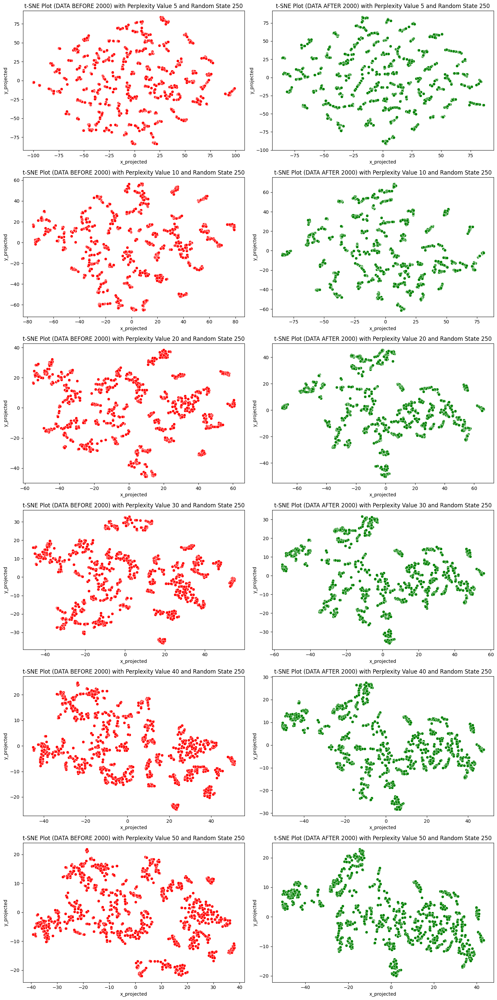

In [ ]:
## Before 2000

fig, axes = plt.subplots(6, 2, figsize=(15, 30))
axes = axes.ravel()

plot_number = 0
for perp in [5, 10, 20, 30, 40, 50]:
    for rs in [250]:
        tsne = TSNE(n_components=2, perplexity=perp, random_state=rs)
        data_tsne = tsne.fit_transform(df1_numerical_scale)
        df_tsne = pd.DataFrame(data_tsne, columns=['x_projected', 'y_projected'])
        df_combo1 = pd.concat([final_df1, df_tsne], axis=1)

        # Plot in the next subplot
        ax = axes[plot_number]
        sns.scatterplot(x='x_projected', y='y_projected', data=df_combo1, color='red', ax=ax)
        ax.set_title(f't-SNE Plot (DATA BEFORE 2000) with Perplexity Value {perp} and Random State {rs}')

        plot_number += 2

plot_number = 1
for perp in [5, 10, 20, 30, 40, 50]:
    for rs in [250]:
        tsne = TSNE(n_components=2, perplexity=perp, random_state=rs)
        data_tsne = tsne.fit_transform(df2_numerical_scale)
        df_tsne = pd.DataFrame(data_tsne, columns=['x_projected', 'y_projected'])
        df_tsne.index = final_df2.index
        df_combo2 = pd.concat([final_df2, df_tsne], axis=1)

        # Plot in the next subplot
        ax = axes[plot_number]
        sns.scatterplot(x='x_projected', y='y_projected', data=df_combo2, color='green', ax=ax)
        ax.set_title(f't-SNE Plot (DATA AFTER 2000) with Perplexity Value {perp} and Random State {rs}')

        plot_number += 2

# Adjust layout and display the figure
plt.tight_layout()
plt.show()

Text(0.5, 1.0, 't-SNE Plot (DATA AFTER 2000) with Perplexity Value 30 and Random State 250')

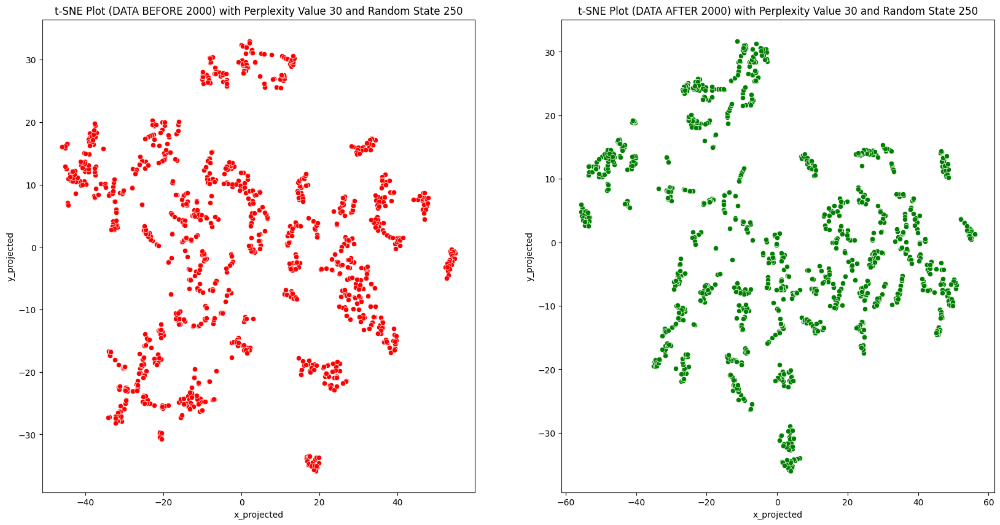

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(20, 10))
axes = axes.ravel()

plot_number = 0
tsne = TSNE(n_components=2, perplexity=30, random_state=250)
data_tsne = tsne.fit_transform(df1_numerical_scale)
df_tsne = pd.DataFrame(data_tsne, columns=['x_projected', 'y_projected'])
df_tsne.index = final_df1.index
df_combo1 = pd.concat([final_df1, df_tsne], axis=1)

ax = axes[plot_number]
sns.scatterplot(x='x_projected', y='y_projected', data=df_combo1, color='red', ax=ax)
ax.set_title(f't-SNE Plot (DATA BEFORE 2000) with Perplexity Value 30 and Random State 250')

plot_number = 1
tsne = TSNE(n_components=2, perplexity=30, random_state=250)
data_tsne = tsne.fit_transform(df2_numerical_scale)
df_tsne = pd.DataFrame(data_tsne, columns=['x_projected', 'y_projected'])
df_tsne.index = final_df2.index
df_combo2 = pd.concat([final_df2, df_tsne], axis=1)

ax = axes[plot_number]
sns.scatterplot(x='x_projected', y='y_projected', data=df_combo2, color='green', ax=ax)
ax.set_title(f't-SNE Plot (DATA AFTER 2000) with Perplexity Value 30 and Random State 250')


#### Underlying Cluster Structure

| Question | Dataset 1 (Before 2000) | Dataset 2 (After 2000)|
|:----------|-------------------------|----------------------|
|Number of clusters| 3 - 4 (Or Multiple Conglomerates) | 3 - 4 (Or Multiple Conglomerates)|
|Balanced in Size | No | No|
|Separation| Maybe 2 Clusters are well separated | Only 1 Cluster is Well Separated |
|Nested Clusters | Yes | Yes |
|Shape| Between spherical to convex | Between spherical to convex |

The total number of clusters is subjective. In this case there is an imaginary elipse that tries to encompasses as many groups of observations that could be potentially together one to each other. Depending on the approach taken, it is possible to consider big cluster gruoups, or small clusters that are not necesarily spherical or convex. That being said, it is also likely that there are several clusters that are highly dense

#### Association between variables and clustering structure

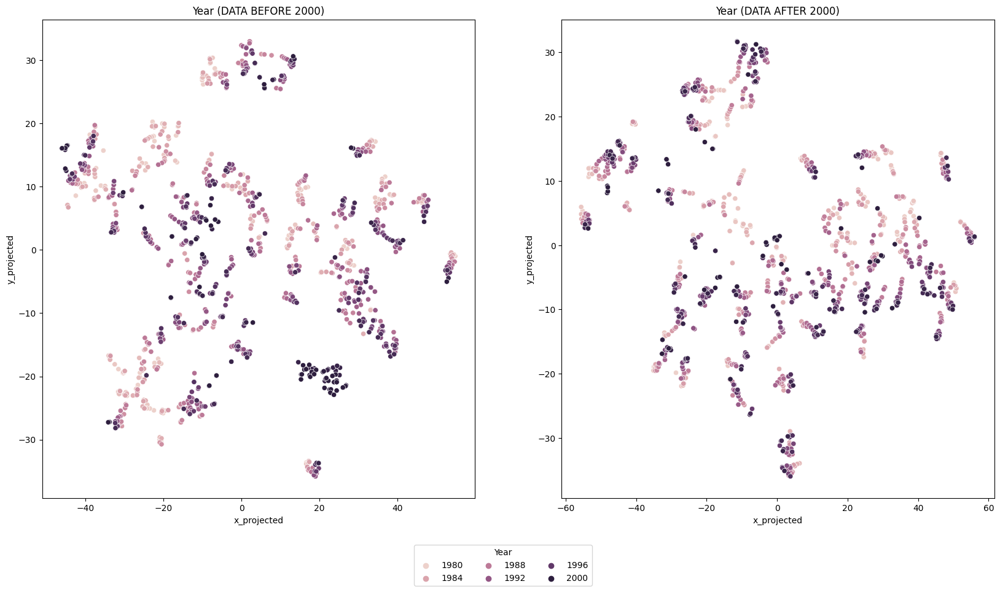

______________________


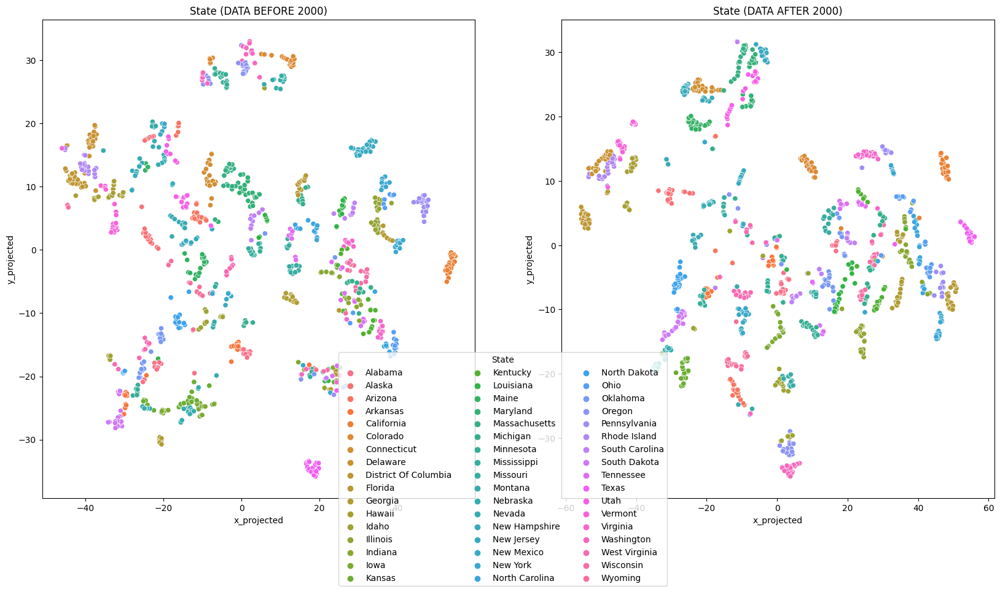

______________________


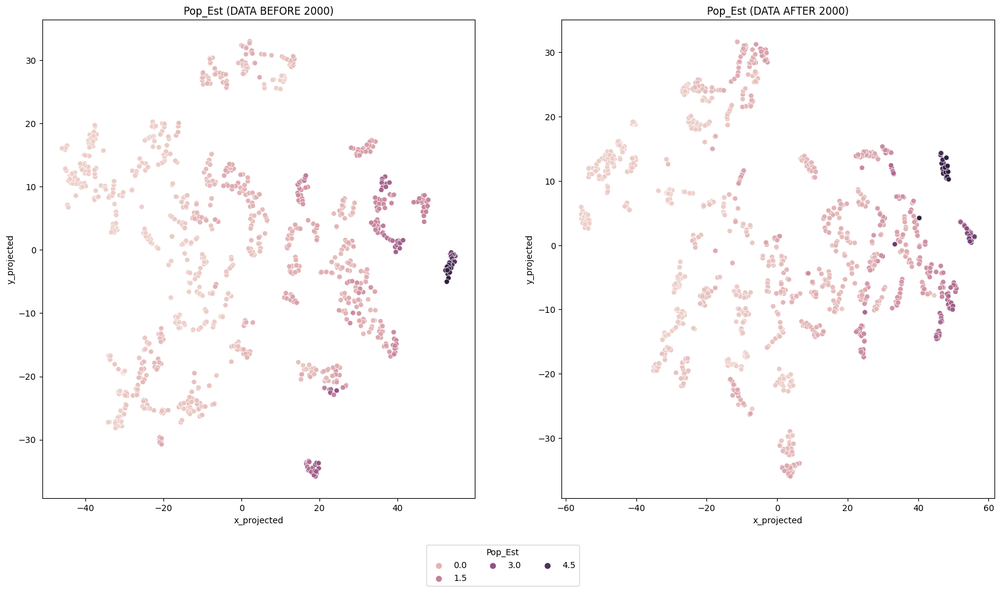

______________________


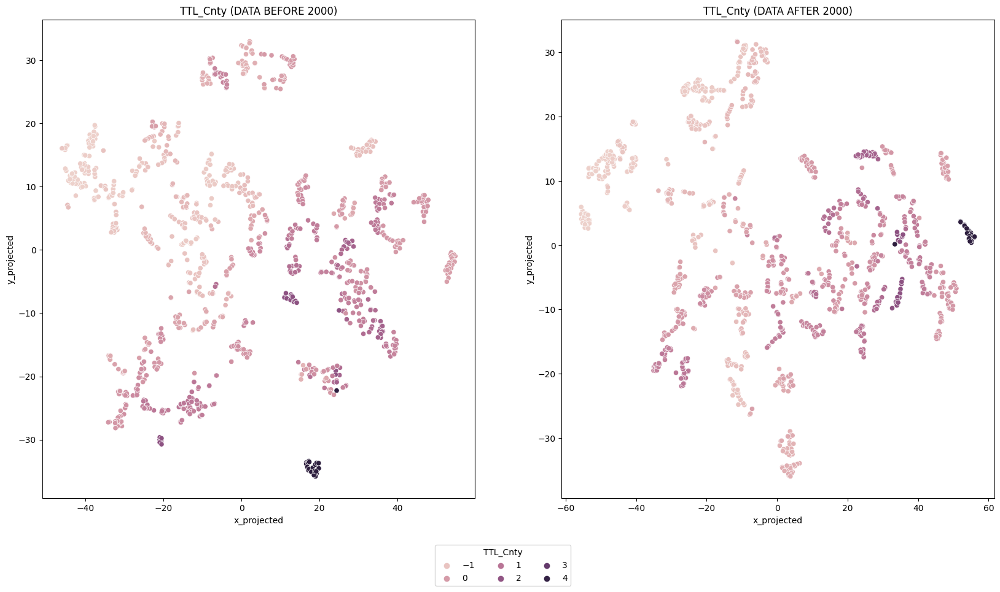

______________________


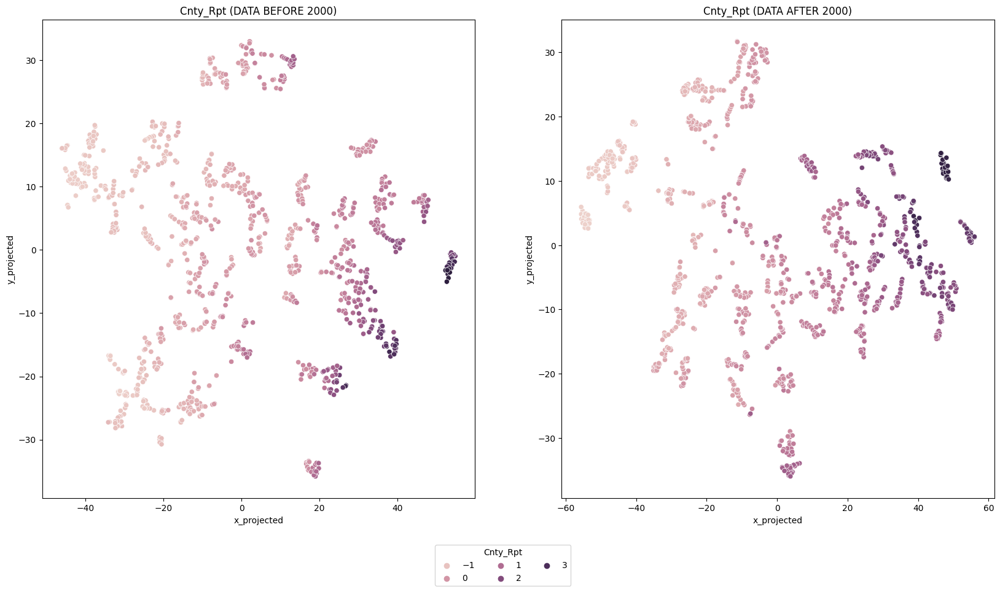

______________________


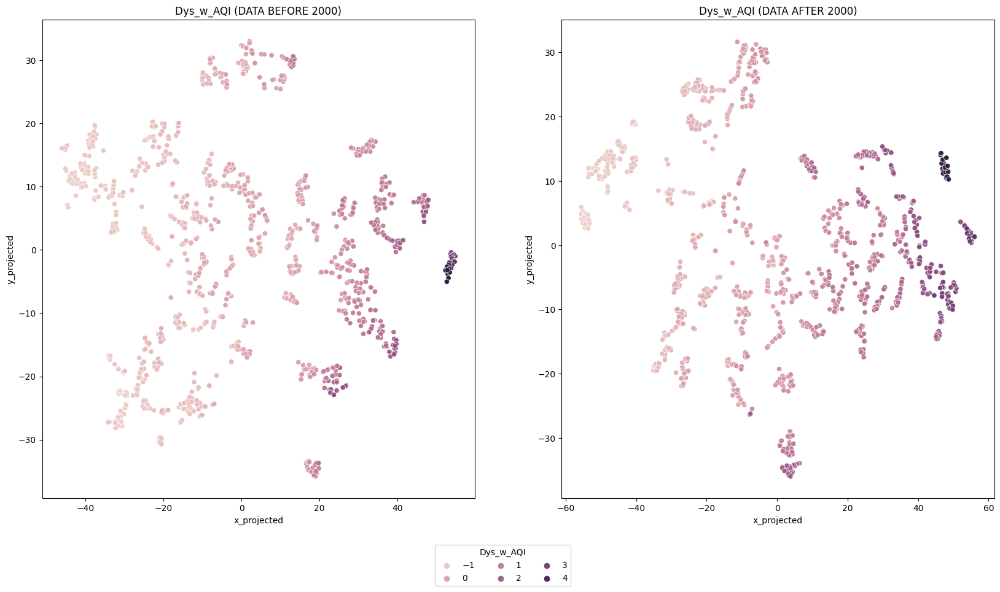

______________________


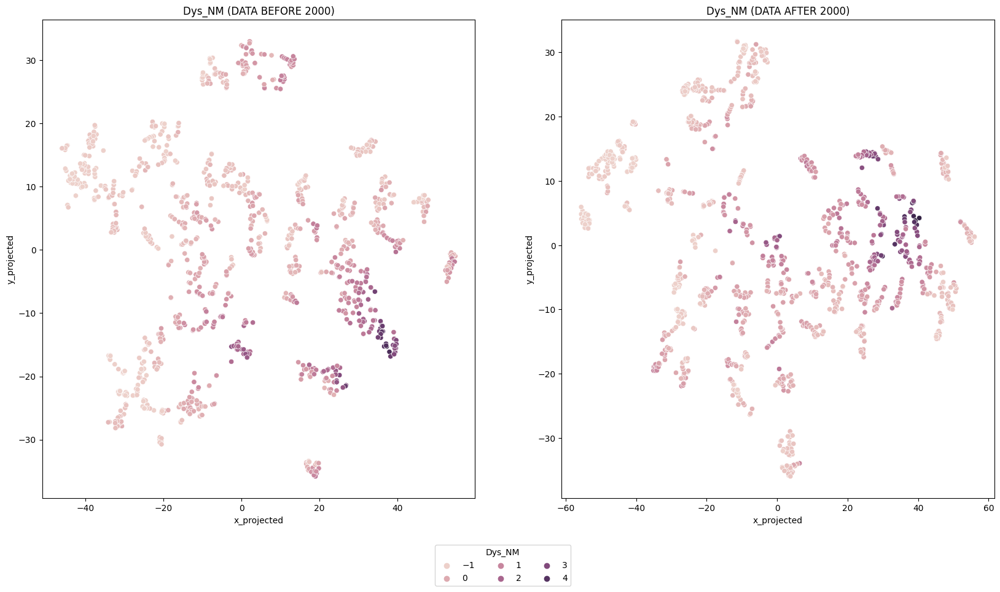

______________________


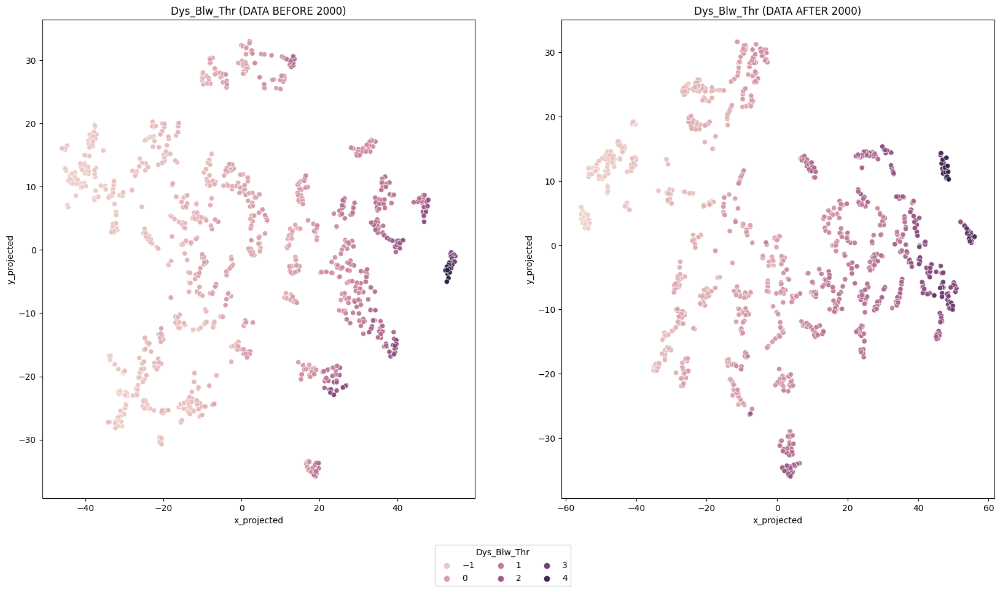

______________________


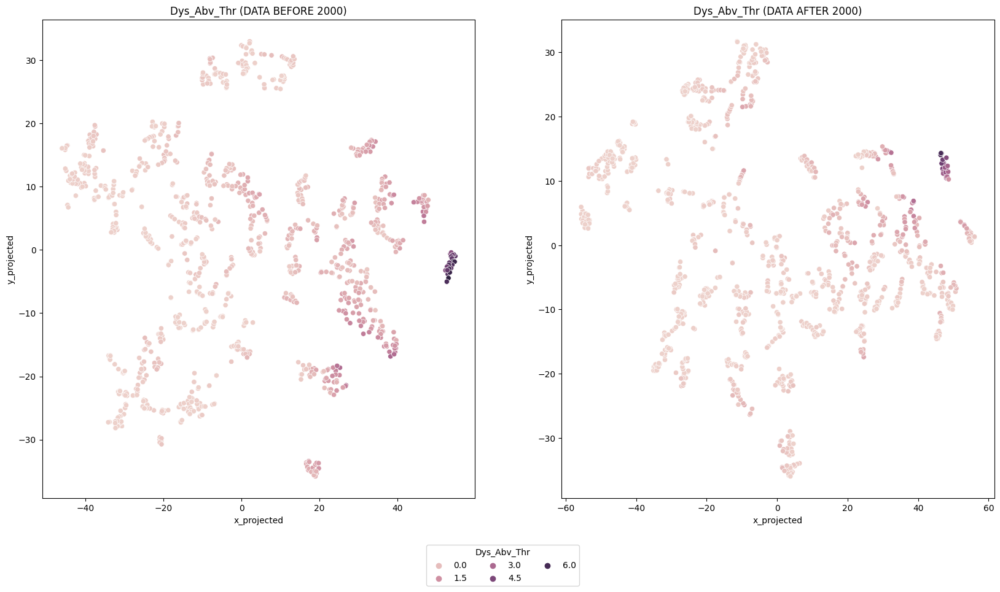

______________________


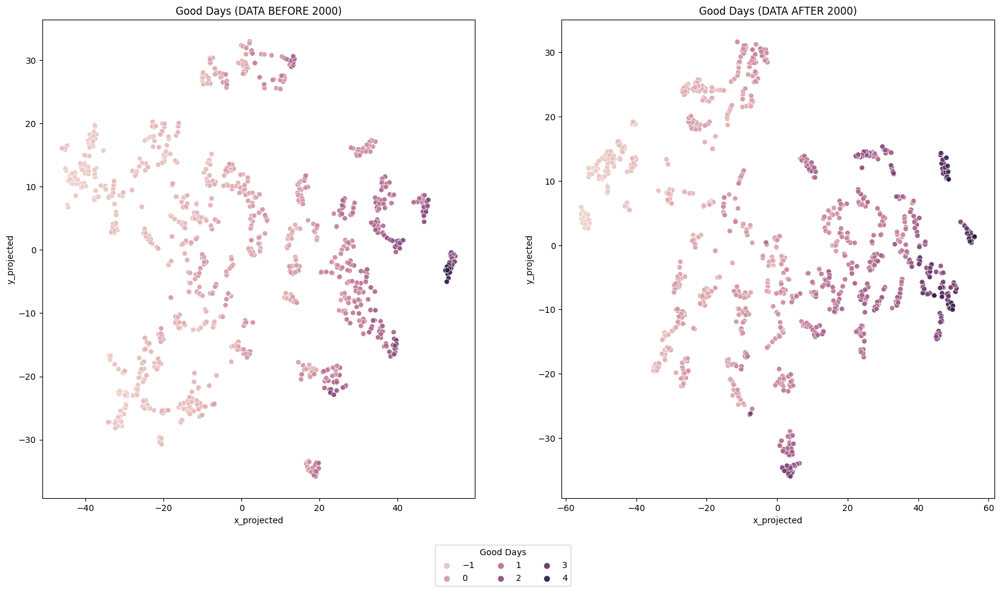

______________________


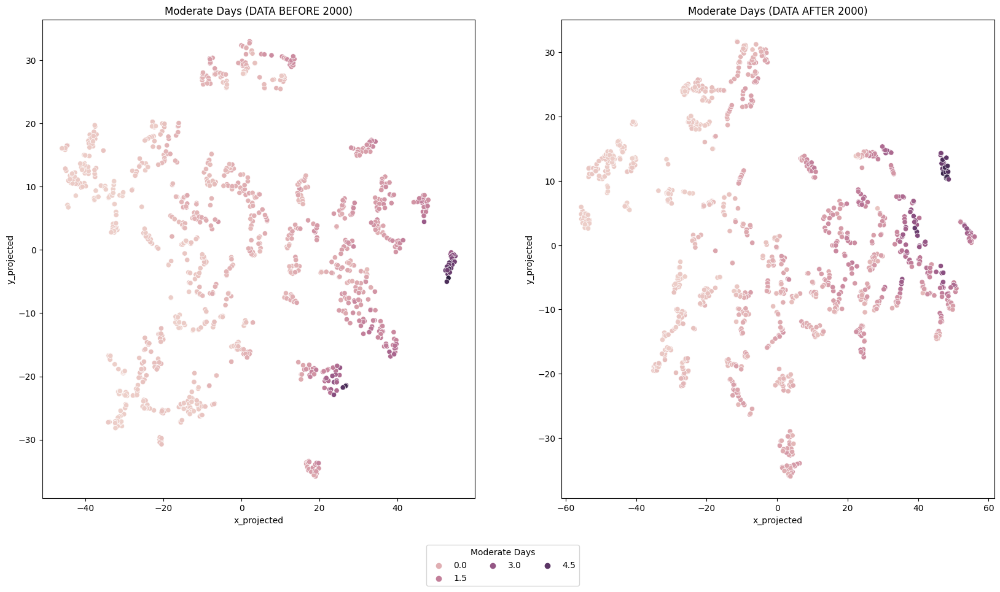

______________________


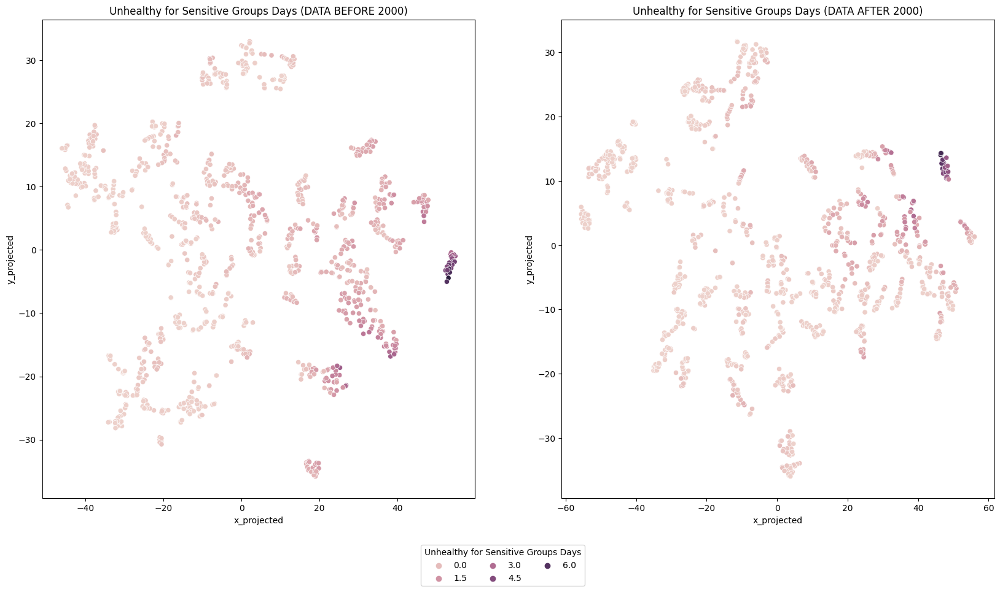

______________________


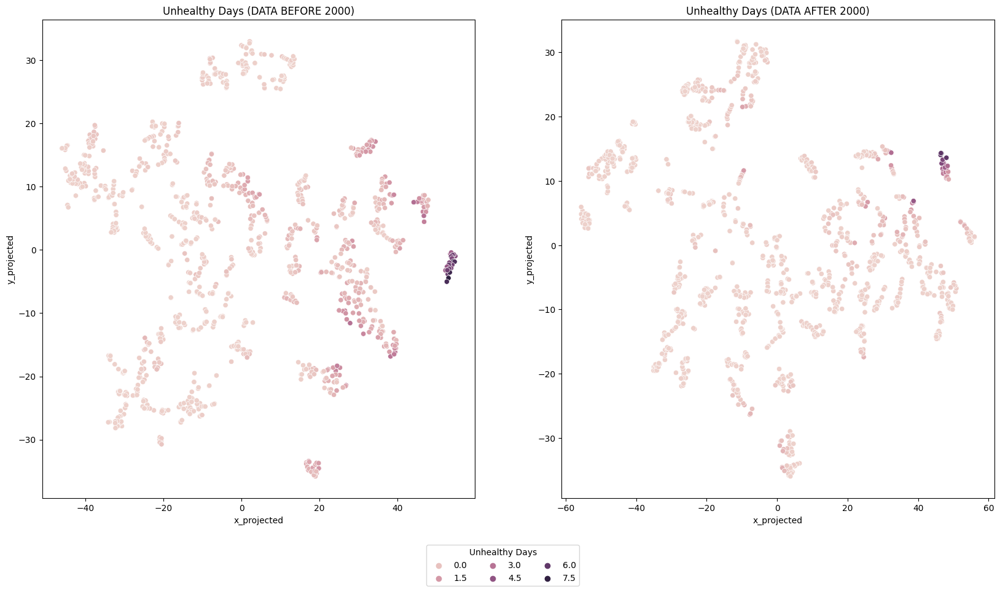

______________________


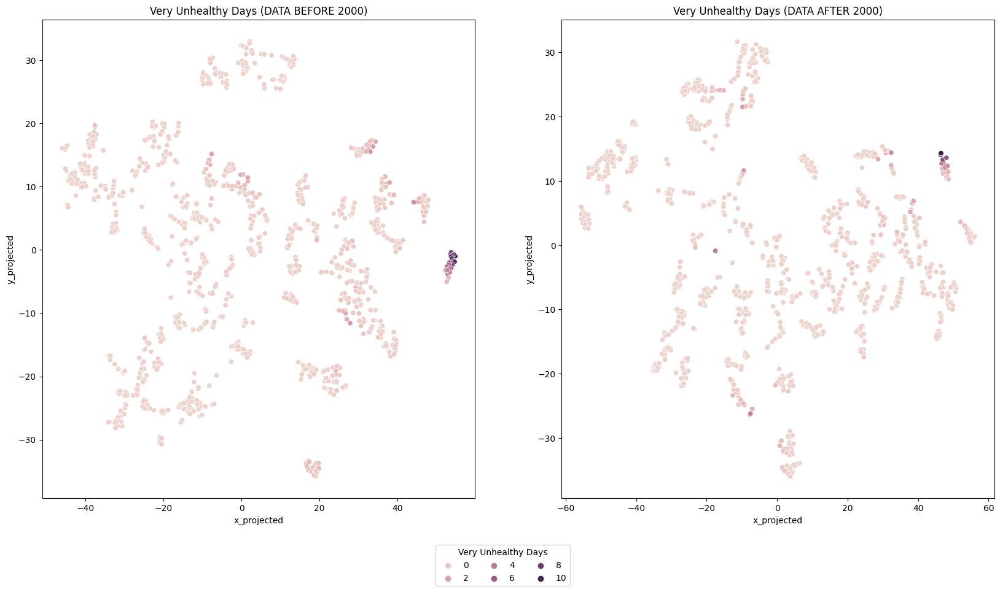

______________________


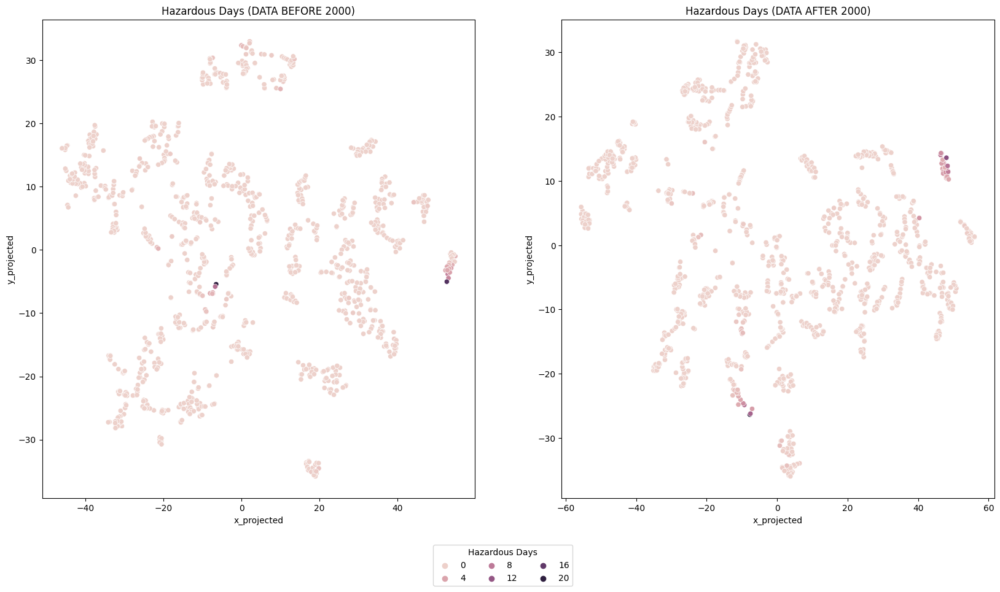

______________________


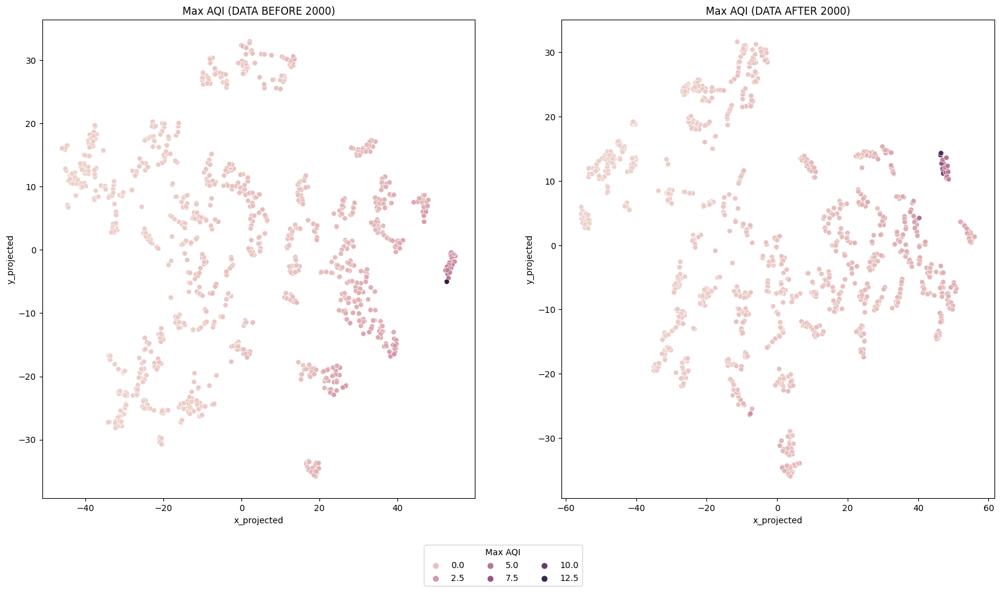

______________________


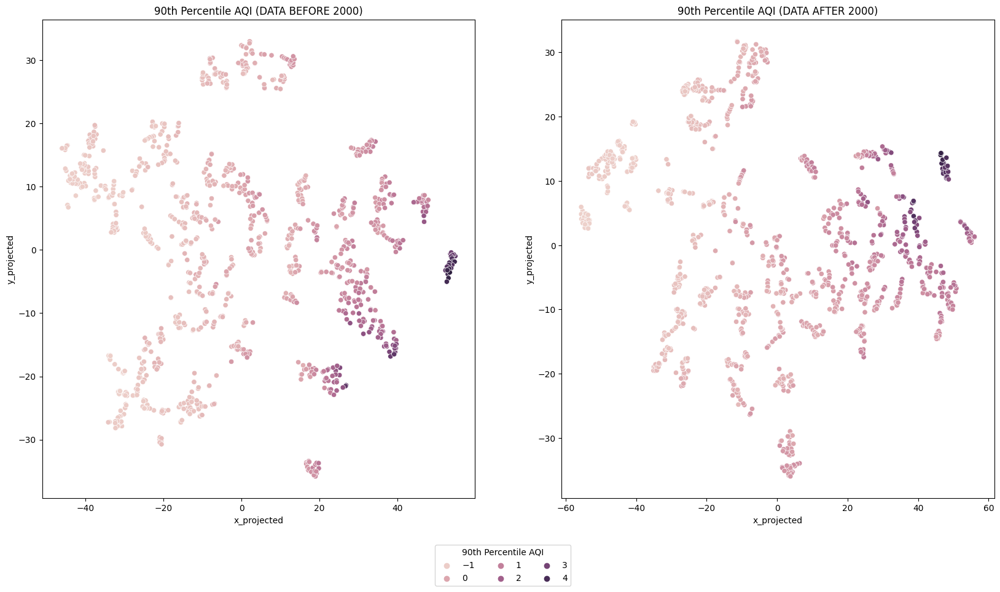

______________________


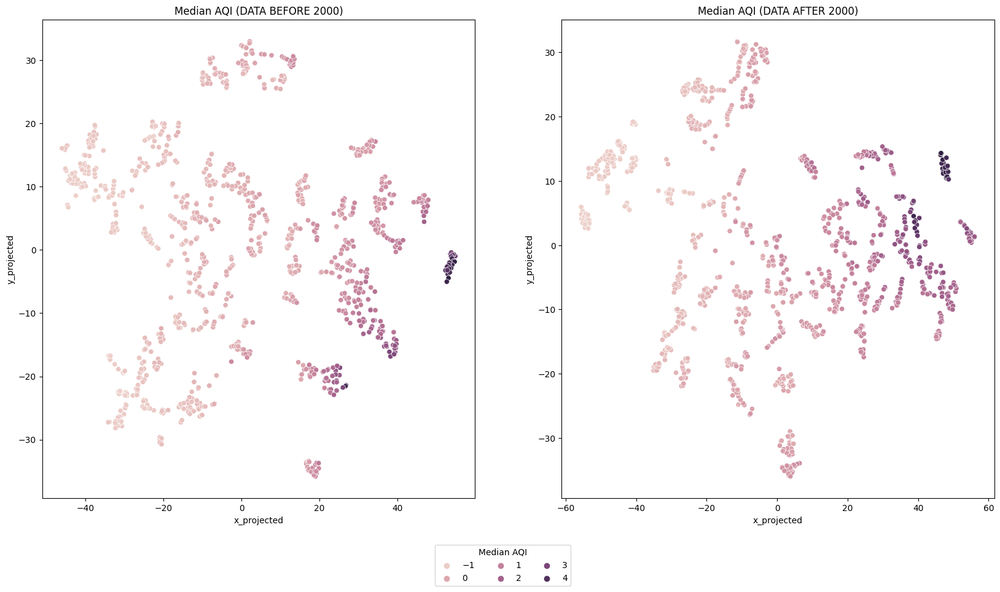

______________________


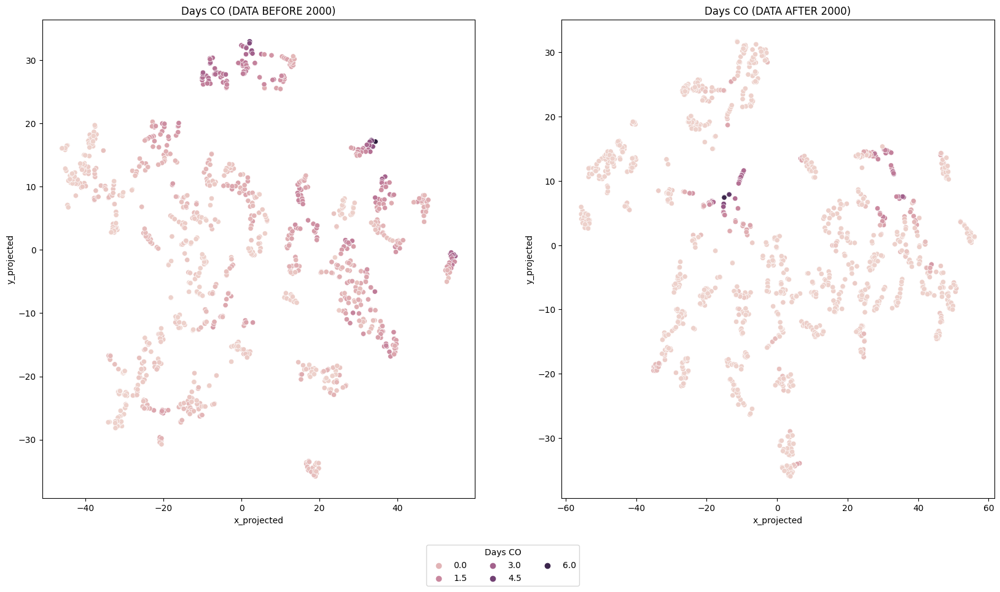

______________________


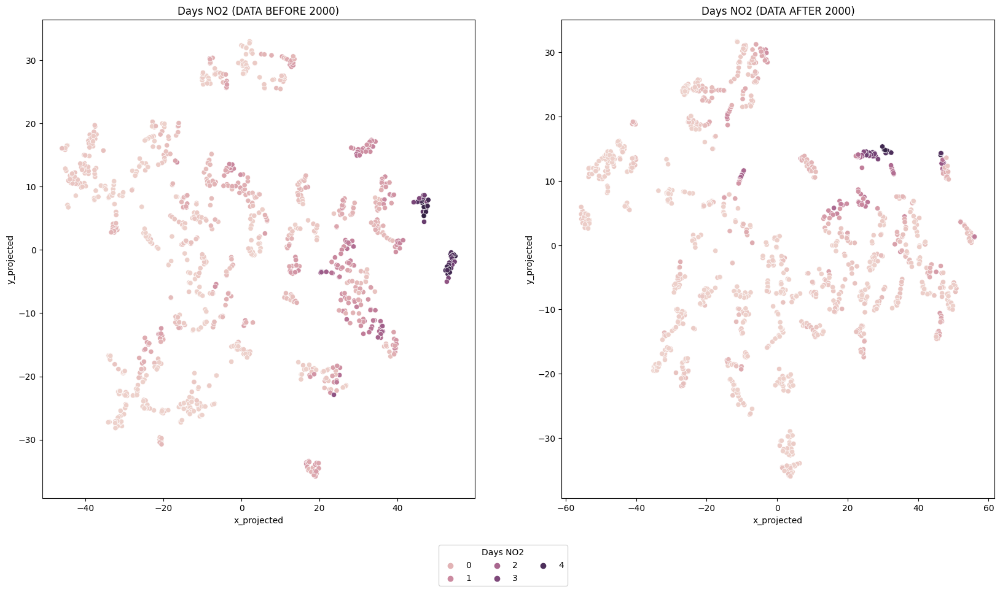

______________________


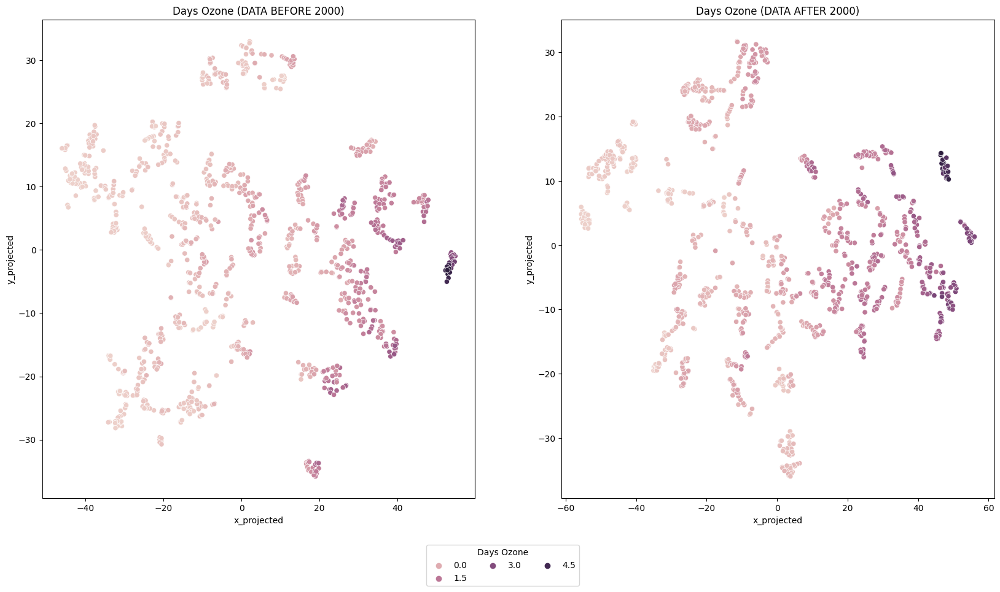

______________________


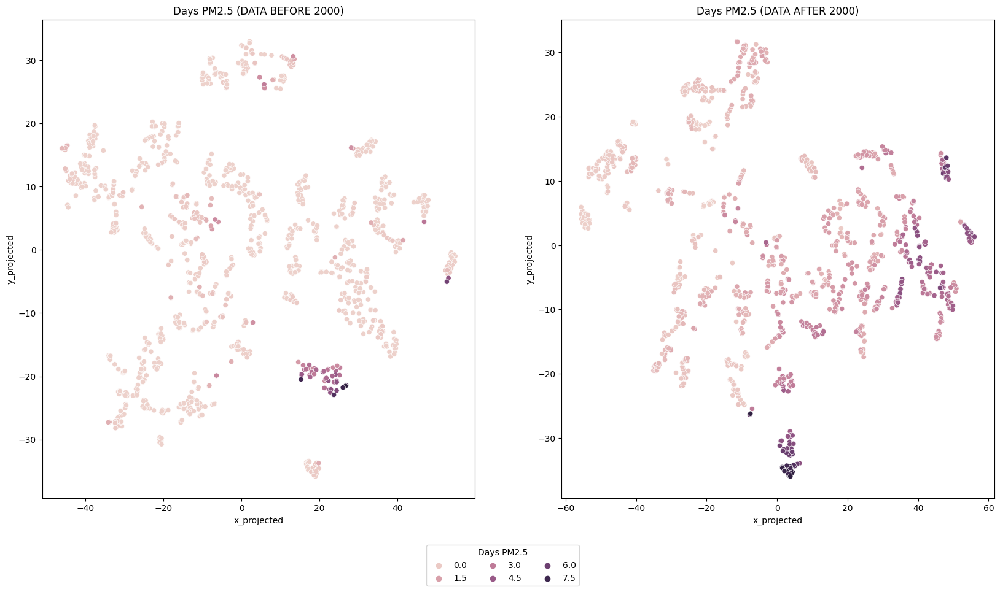

______________________


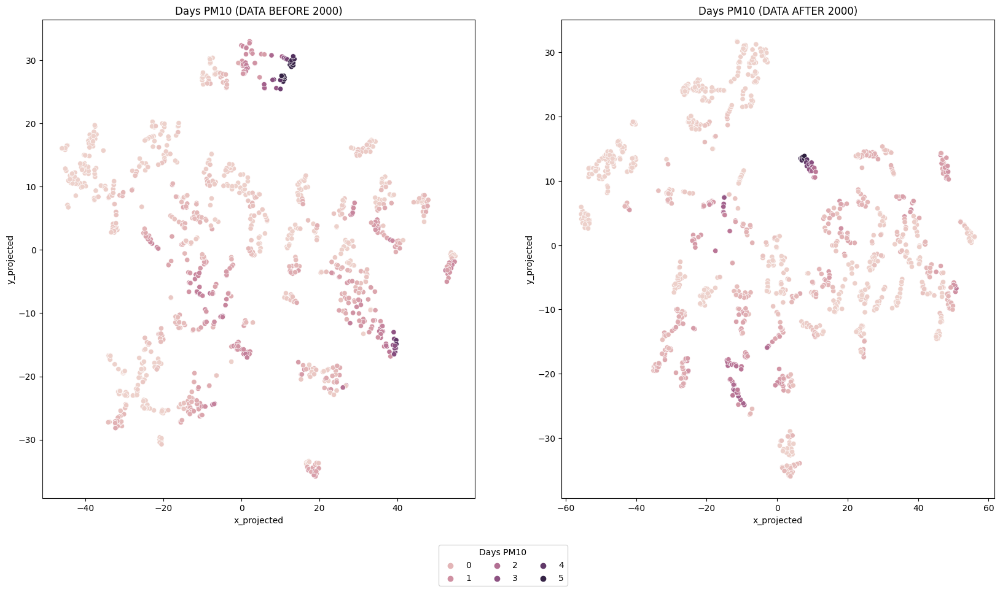

______________________


In [ ]:
for i in range(1,24):
    fig, axes = plt.subplots(1, 2, figsize=(20, 10))
    axes = axes.ravel()

    col = df_combo1.columns[i]
    plot_number = 0
    ax1 = axes[plot_number]
    sns.scatterplot(x='x_projected', y='y_projected', data=df_combo1, hue = col, ax=ax1)
    ax1.set_title(f'{col} (DATA BEFORE 2000)')

    col = df_combo2.columns[i]
    plot_number = 1
    ax2 = axes[plot_number]
    sns.scatterplot(x='x_projected', y='y_projected', data=df_combo2, hue = col, ax=ax2)
    ax2.set_title(f'{col} (DATA AFTER 2000)')


    handles, labels = ax1.get_legend_handles_labels()
    fig.legend(handles, labels, loc='lower center', title = col, ncol=3, bbox_to_anchor=(0.5, -0.05))

    # Remove individual legends from subplots
    ax1.get_legend().remove()
    ax2.get_legend().remove()

    plt.subplots_adjust(bottom=0.1)
    plt.show()
    print('______________________')



It is possible to observe for most of the variables an association between the clustering structure and the observations in each variable. For example, for the states, in most of the cases each state appears to be its own clusters, also there is a single cluster with uhealthy AQI reported or clusters where the number of days where NO2 was the main polutant is very high.


#### tSNE - Considerations

**NOTE : It is important to highlight, that the t-SNE plot previously displayed does not provide information related to the original dataset properties when it comes to displaying the distance between objects, the distance between clusters, the sparsity of the cluster, and the location of clusters in the dataset, the previous due to the deterministic nature of the algorithm**

## 7. Clustering Algorithm Selection Motivation

### Clustering Algorithm #1
### - DBSCAN
DBSCAN is a density based algorithm, therefore it has the capacity of identifying clusters that have different shapes that are not necesarily spherical. By looking at the plots previously showed, the data appears to form conglomerates that could be seen as highly dense points and these conglomerates do not appear to have fully spherical shapes that could benefit the use of other clustering algorythms. In our research question, we are interested in analyzing how the clustering structure in AQI report changes in 40 years by analyzing two periods, each one of 20 years. The clustering structure in each period is very similar, with the presence of these conglomerates with shapes that are not fully distinctive in the clusters. Therefore the usage of DBSCAN for identifying this clustering structure is applicable for our research question. Given that we do not know in reality the number of clusters, by using DBSCAN we can properly circunvent this limitation which is an advantage provided by the algorithm. Ideally this algorithm works well in clusters that are well separated and have similar sparsities (Densities), these properties are not 100% met in our datasets. The conglomerates are not fully well separated one from each other, and there are observations that even though they are not identified as noise, could impact the overal performance of the algorythm. An alternative to DBSCAN in this case could be HDBSCAN which is more robust when clusters have different levels of sparsity and is a deterministic algorithm but we did not cover this method in class.


### Clustering Algorithm #2
### - Spectral Clustering

In [ ]:
##DBSCAN



## Pending
Follow Up Question:
With what you have observed about the nature of the dataset clustering structure and your particular research motivation, do you believe that there is any benefit to returning a fuzzy clustering of the dataset? Explain. If so, how might this result be useful with respect to your research motivation?

## Pending
Follow Up Question:
With what you have observed about the nature of the dataset clustering structure and your particular research motivation, do you believe that there is any benefit to returning a hierarchical clustering of the dataset? Explain. If so, how might this result be useful with respect to your research motivation?

## 8. Clustering Algorithm Practical Considerations

## Pending
* Is this a non-deterministic algorithm?
* If so, in a more complete analysis, how might you handle the fact that this algorithm may give you different clustering results based on different random states? Could some results be better than others? * Suppose that you have already clustered this dataset with your clustering algorithm that you selected. Now suppose that there were some additional observations that you would like to cluster along with the observations in this dataset as well. Would you have to rerun the entire clustering algorithm again to cluster these new observations? If not, describe how you might sensibly cluster these new observations into your existing clustering without running the whole algorithm again.

## 9. Clustering Algorithm #1



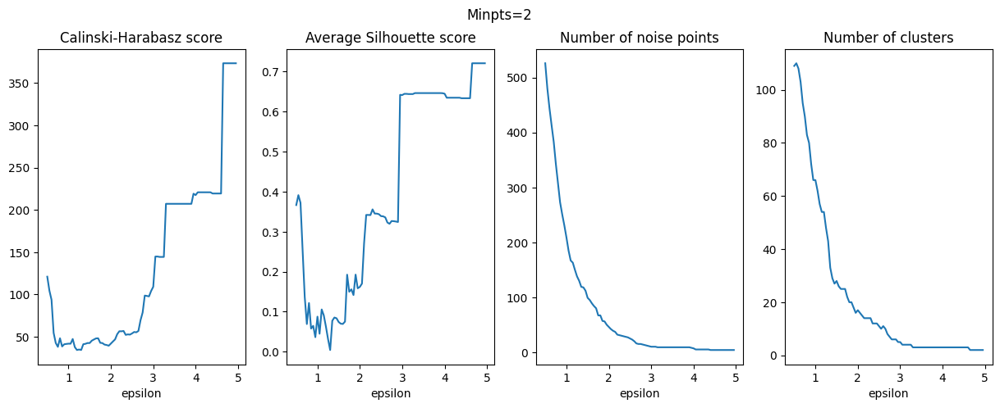

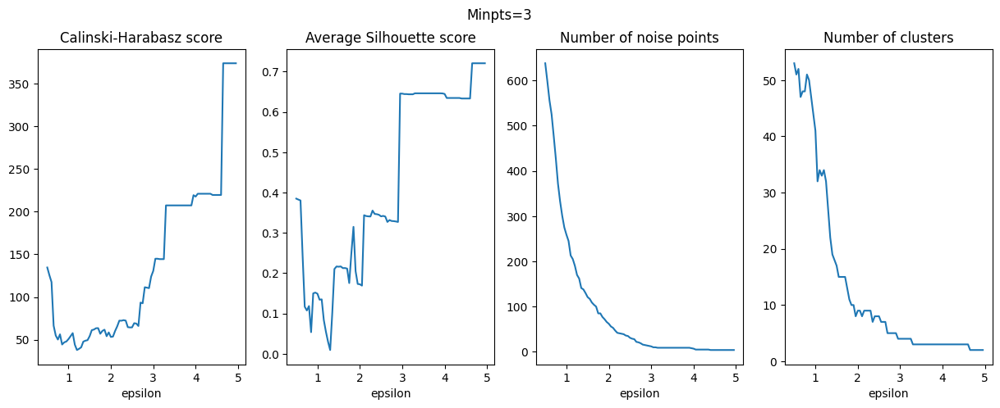

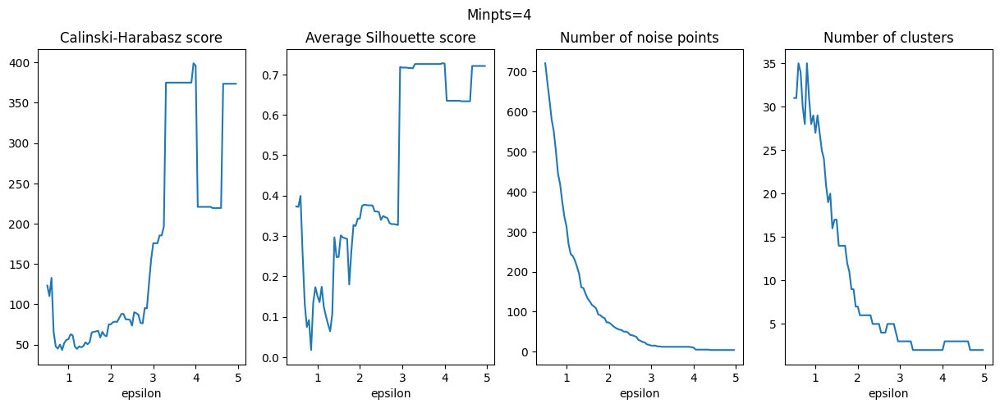

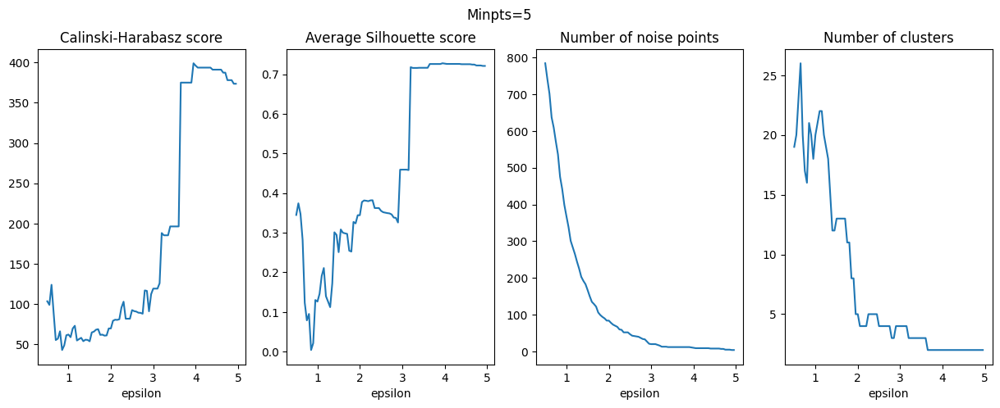

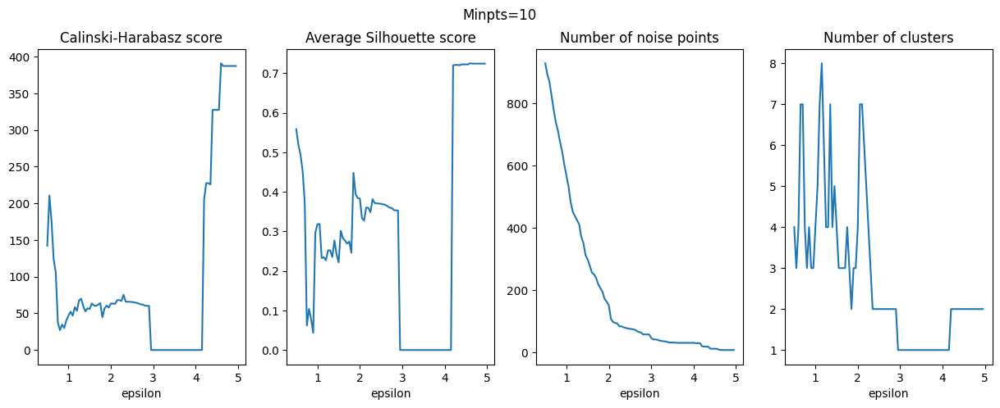

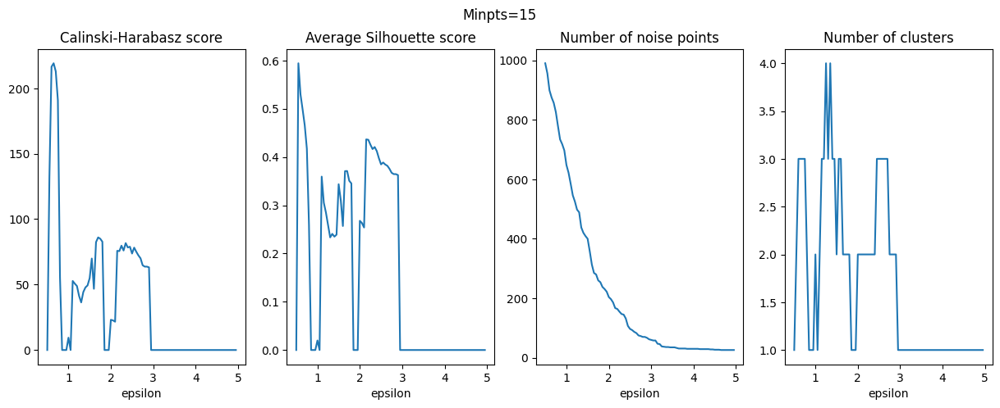

In [50]:
# Perform the preliminary analysis
for minpts in [2,3,4,5,10, 15]:
    calinski_harabazs_scores = []
    silhouette_scores = []
    num_clusters = []
    num_noise_points = []


    num_clusters_p = []
    n_noise_points_p = []
    silhouette_scores_p = []
    calinski_harabazs_scores_p = []

    for eps in np.arange(0.5, 5, 0.05):
        #Cluster the dataset using DBSCAN
        dst = DBSCAN(eps=eps, min_samples=minpts, metric='euclidean')
        df_combo1['predicted_cluster'] = dst.fit_predict(df1_numerical_scale)

        #Get the number of clusters in the clustering
        k=len(df_combo1['predicted_cluster'].value_counts())-1
        num_clusters.append(k)

        #Get the number of noise points
        noise_point_num=len(df_combo1[df_combo1['predicted_cluster']==-1])
        num_noise_points.append(noise_point_num)

        #Average silhouette score of the clustering
        if k>1:
            silhouette_scores.append(silhouette_score(df1_numerical_scale[df_combo1['predicted_cluster']!=-1],
                                                              df_combo1[df_combo1['predicted_cluster']!=-1]['predicted_cluster']))
        else:
            #(If there is only one cluster, then the average silhouette score is 0)
            silhouette_scores.append(0)
        #Calinski-Harabasz score of the clsutering
        if k>1:
            calinski_harabazs_scores.append(calinski_harabasz_score(df1_numerical_scale[df_combo1['predicted_cluster']!=-1],
                                                                        df_combo1[df_combo1['predicted_cluster']!=-1]['predicted_cluster']))
        else:
            calinski_harabazs_scores.append(0)

    # Show the results of the preliminary analysis
    fig, ax = plt.subplots(1, 4, figsize=(15, 5), sharex=True)

    eps = np.arange(0.5, 5, 0.05)
    fig.suptitle('Minpts=%s'%minpts)
    ax[0].plot(eps, calinski_harabazs_scores)
    ax[1].plot(eps, silhouette_scores)
    ax[2].plot(eps, num_noise_points)
    ax[3].plot(eps, num_clusters)

    ax[0].set_title('Calinski-Harabasz score')
    ax[1].set_title('Average Silhouette score')
    ax[2].set_title('Number of noise points')
    ax[3].set_title('Number of clusters')

    #ax[0].set_yticks(np.arange(5, 60, 7))
    ax[0].set_xlabel('epsilon')
    ax[1].set_xlabel('epsilon')
    ax[2].set_xlabel('epsilon')
    ax[3].set_xlabel('epsilon')
    plt.show()

DBSCAN after 2000s

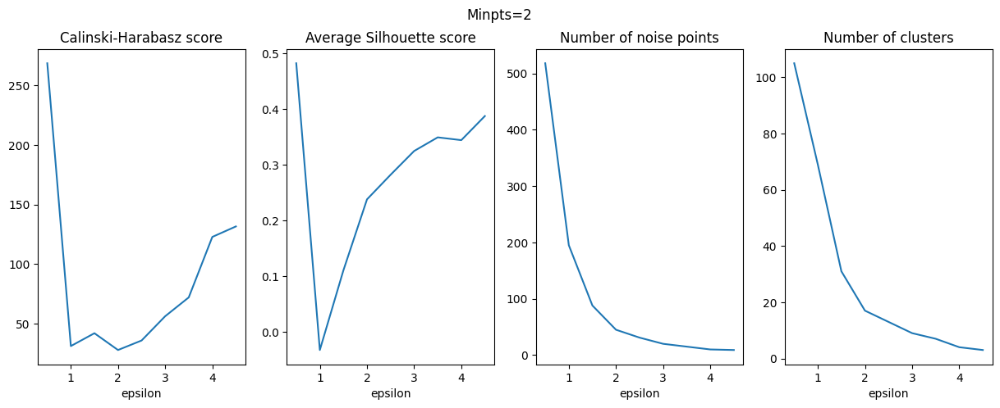

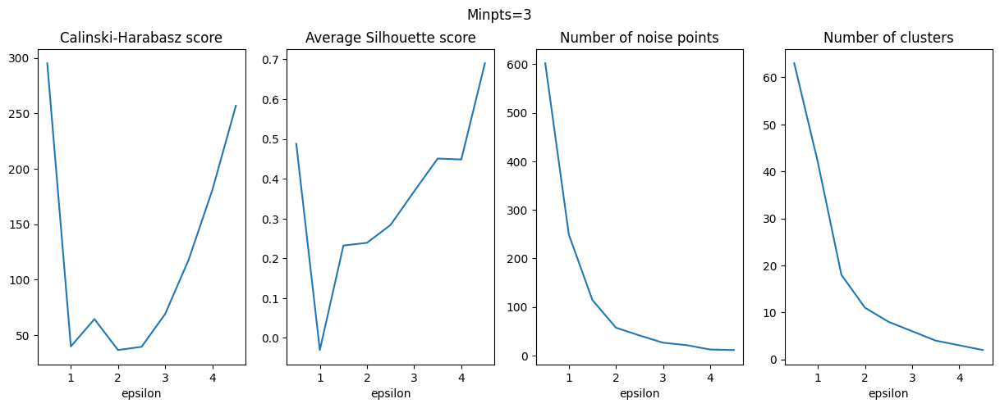

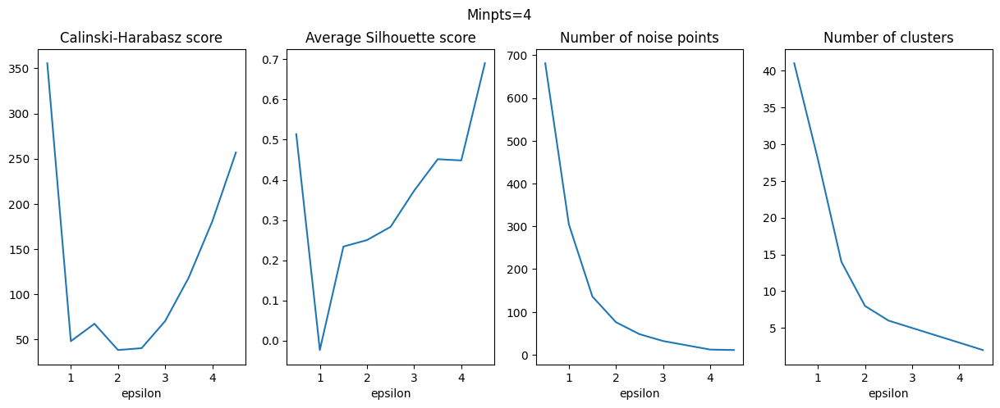

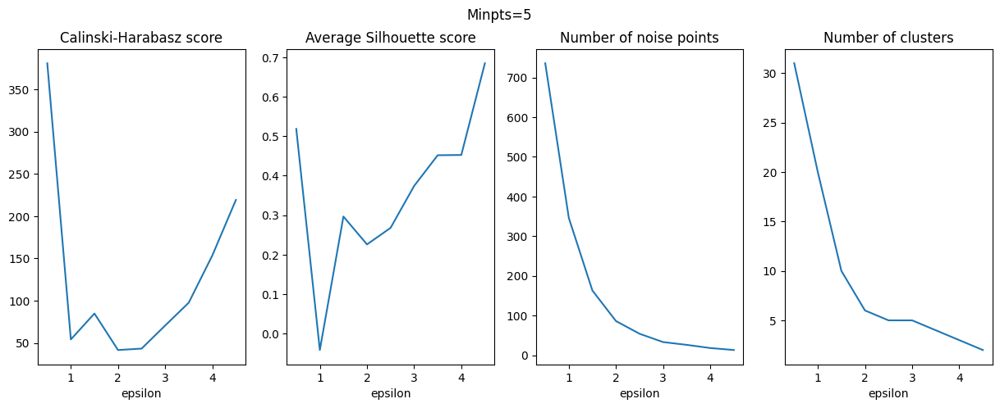

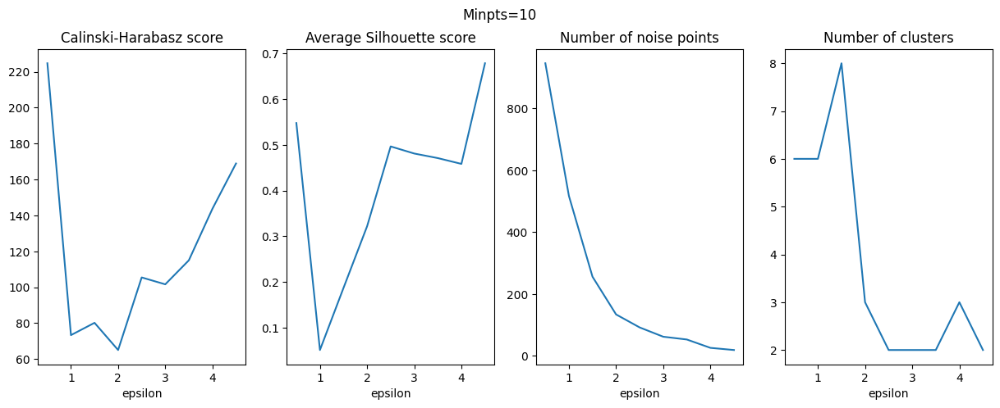

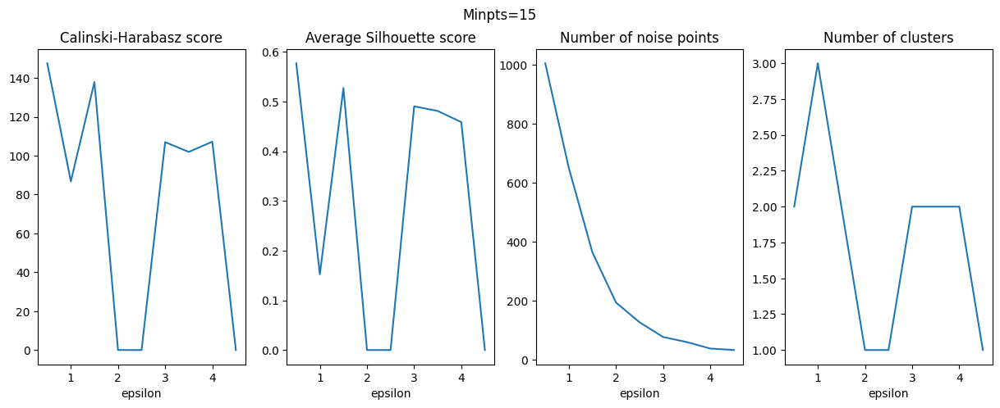

In [52]:
# Perform the preliminary analysis
for minpts in [2,3,4,5,10,15]:
    calinski_harabazs_scores = []
    silhouette_scores = []
    num_clusters = []
    num_noise_points = []


    num_clusters_p = []
    n_noise_points_p = []
    silhouette_scores_p = []
    calinski_harabazs_scores_p = []

    for eps in np.arange(0.5, 5, 0.5):
        #Cluster the dataset using DBSCAN
        dst = DBSCAN(eps=eps, min_samples=minpts, metric='euclidean')
        df_combo2['predicted_cluster'] = dst.fit_predict(df2_numerical_scale)

        #Get the number of clusters in the clustering
        k=len(df_combo2['predicted_cluster'].value_counts())-1
        num_clusters.append(k)

        #Get the number of noise points
        noise_point_num=len(df_combo2[df_combo2['predicted_cluster']==-1])
        num_noise_points.append(noise_point_num)

        #Average silhouette score of the clustering
        if k>1:
            silhouette_scores.append(silhouette_score(df2_numerical_scale[df_combo2['predicted_cluster']!=-1],
                                                              df_combo2[df_combo2['predicted_cluster']!=-1]['predicted_cluster']))
        else:
            #(If there is only one cluster, then the average silhouette score is 0)
            silhouette_scores.append(0)
        #Calinski-Harabasz score of the clsutering
        if k>1:
            calinski_harabazs_scores.append(calinski_harabasz_score(df2_numerical_scale[df_combo2['predicted_cluster']!=-1],
                                                                        df_combo2[df_combo2['predicted_cluster']!=-1]['predicted_cluster']))
        else:
            calinski_harabazs_scores.append(0)

    # Show the results of the preliminary analysis
    fig, ax = plt.subplots(1, 4, figsize=(15, 5), sharex=True)

    eps = np.arange(0.5, 5, 0.5)
    fig.suptitle('Minpts=%s'%minpts)
    ax[0].plot(eps, calinski_harabazs_scores)
    ax[1].plot(eps, silhouette_scores)
    ax[2].plot(eps, num_noise_points)
    ax[3].plot(eps, num_clusters)

    ax[0].set_title('Calinski-Harabasz score')
    ax[1].set_title('Average Silhouette score')
    ax[2].set_title('Number of noise points')
    ax[3].set_title('Number of clusters')

    #ax[0].set_yticks(np.arange(5, 60, 7))
    ax[0].set_xlabel('epsilon')
    ax[1].set_xlabel('epsilon')
    ax[2].set_xlabel('epsilon')
    ax[3].set_xlabel('epsilon')
    plt.show()

In [55]:
df_minpts_4_stats=pd.DataFrame({'epsilon': np.arange(0.5, 5, 0.5),
                                'ch_score': calinski_harabazs_scores,
                                'avg_ss': silhouette_scores,
                                'noise_points': num_noise_points,
                                'num_clusters': num_clusters})
df_minpts_4_stats

,epsilon,ch_score,avg_ss,noise_points,num_clusters
0,0.5,147.576859,0.576796,1005,2
1,1.0,86.786202,0.152329,650,3
2,1.5,137.925460,0.526864,364,2
3,2.0,0.000000,0.000000,194,1
4,2.5,0.000000,0.000000,127,1
5,3.0,106.990601,0.490184,77,2
6,3.5,101.952426,0.480864,60,2
7,4.0,107.230884,0.458422,38,2
8,4.5,0.000000,0.000000,33,1


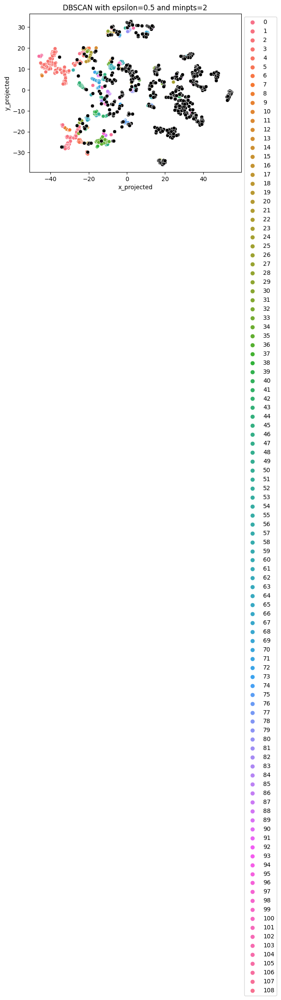

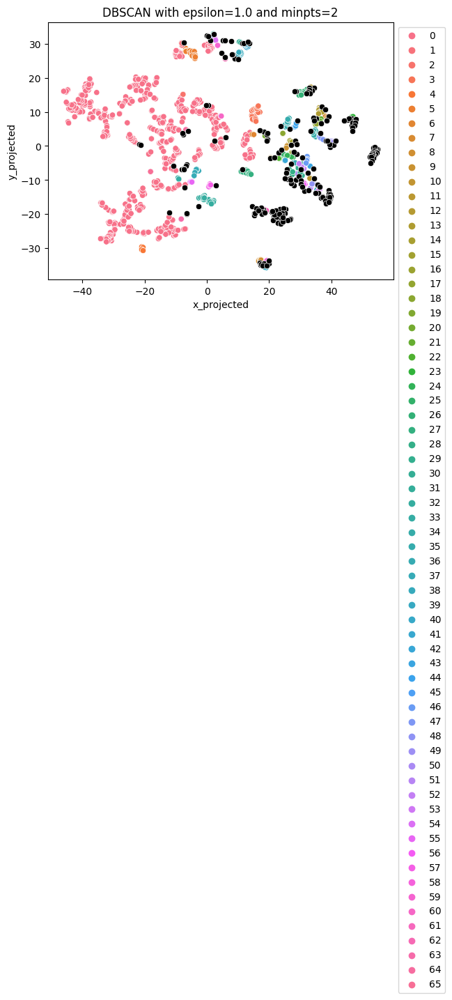

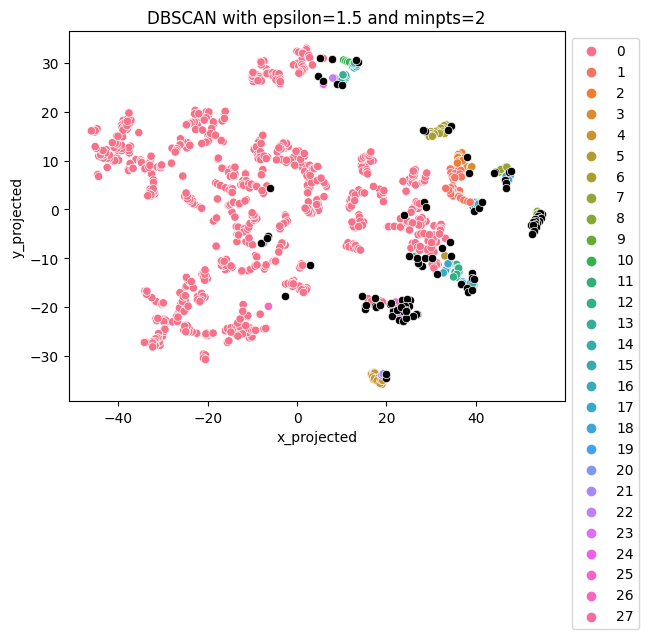

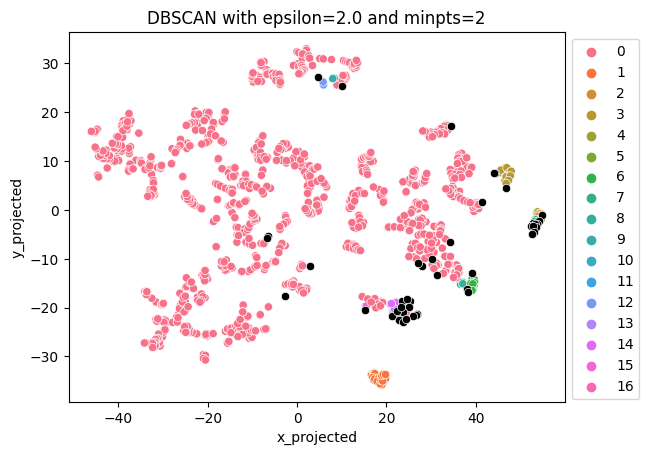

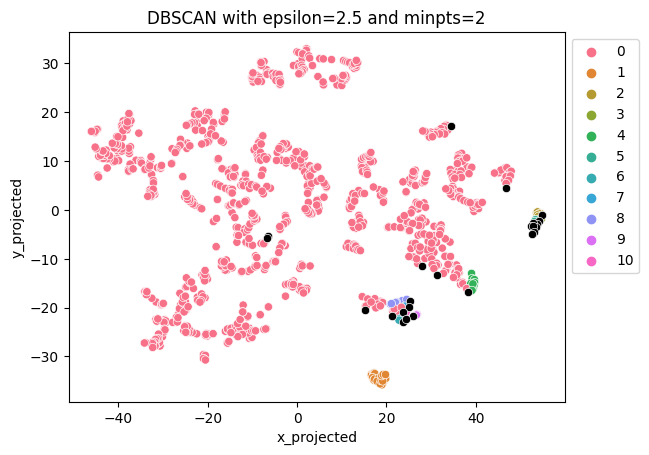

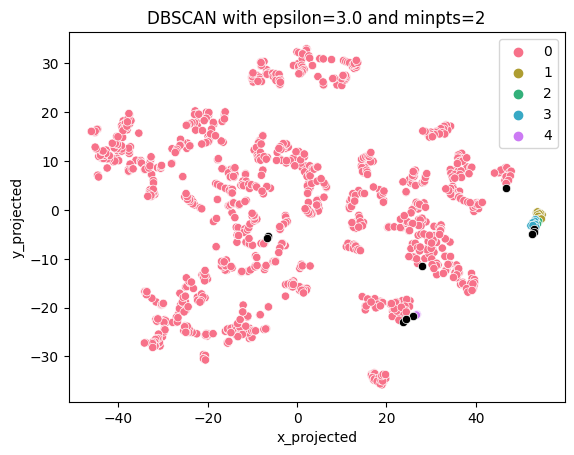

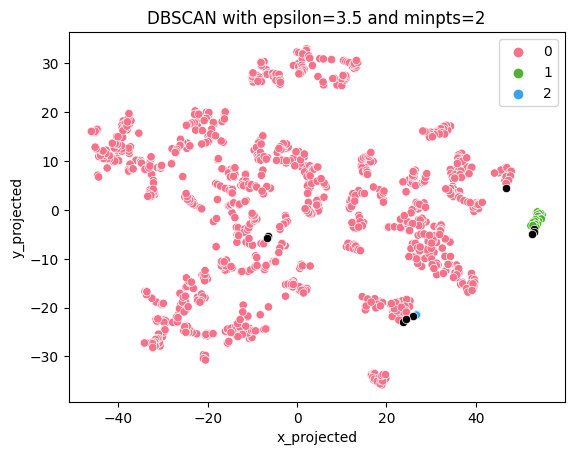

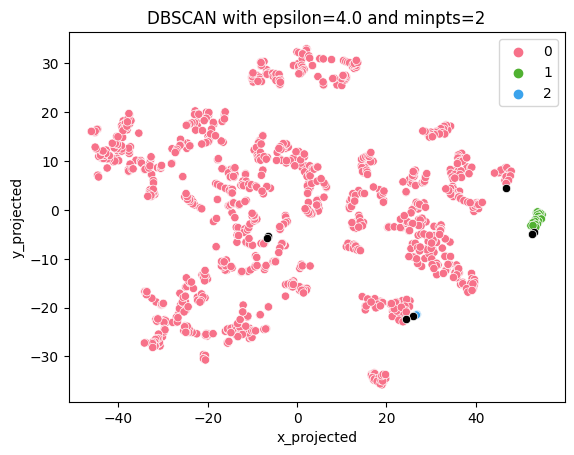

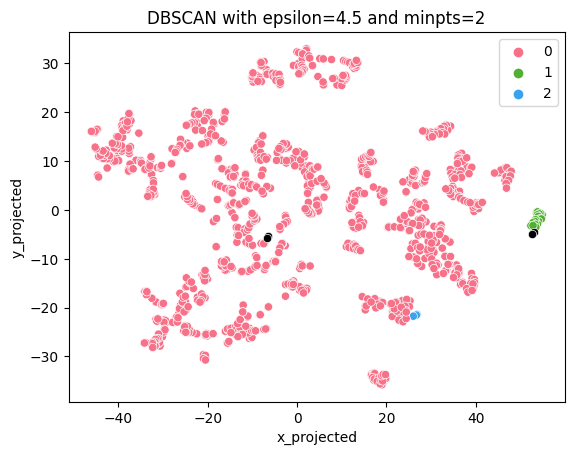

In [63]:
for eps in np.arange(0.5,5,0.5):
    dst = DBSCAN(eps=eps, min_samples=2, metric='euclidean')
    df_combo1['predicted_cluster'] = dst.fit_predict(df1_numerical_scale)
    k=len(df_combo1['predicted_cluster'].value_counts())
    sns.scatterplot(x='x_projected',y='y_projected', hue='predicted_cluster',
                    palette=sns.color_palette("husl", k-1), data=df_combo1[df_combo1['predicted_cluster']>=0])
    sns.scatterplot(x='x_projected',y='y_projected',
                    color='black', data=df_combo1[df_combo1['predicted_cluster']==-1])
    plt.title('DBSCAN with epsilon=%s and minpts=%s' %(eps,2))
    plt.legend(bbox_to_anchor=(1,1))
    plt.show()

after 2000s

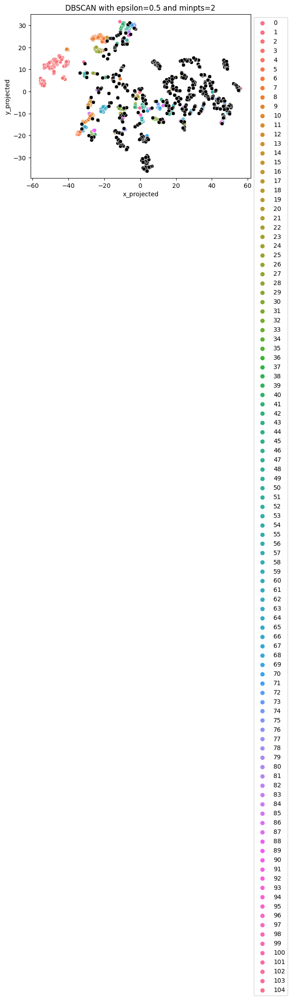

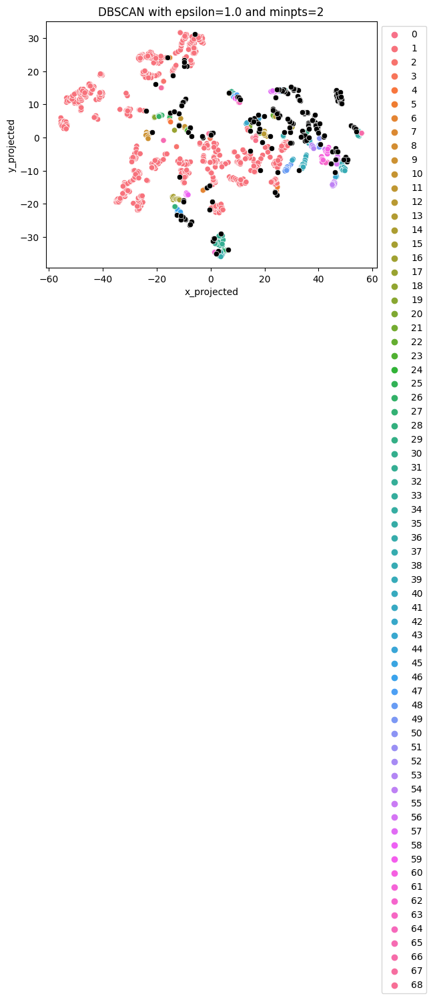

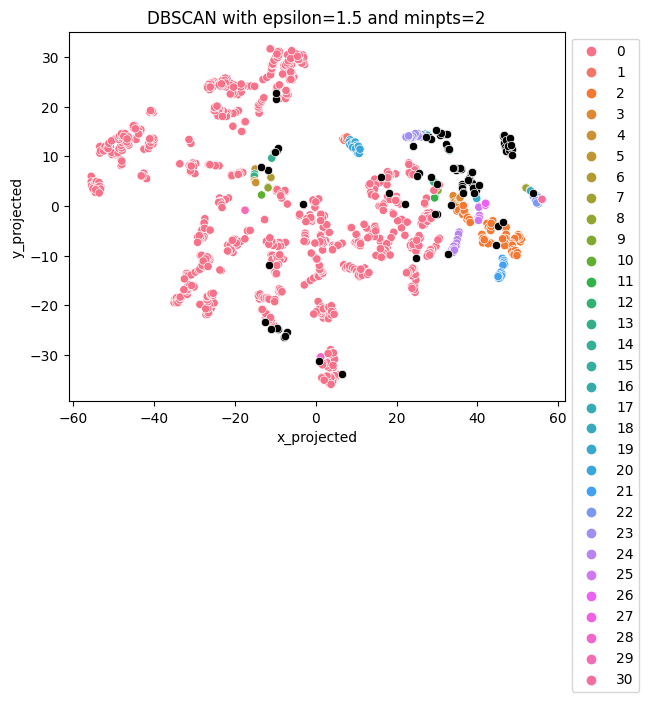

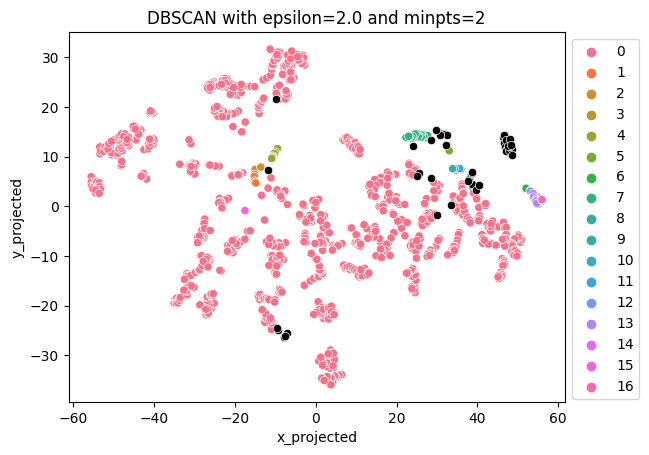

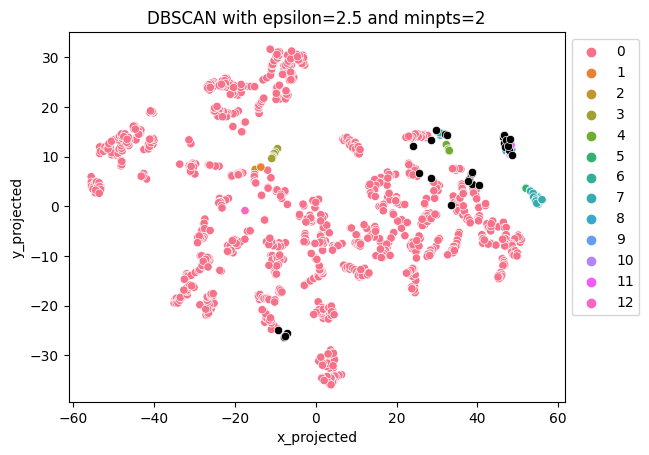

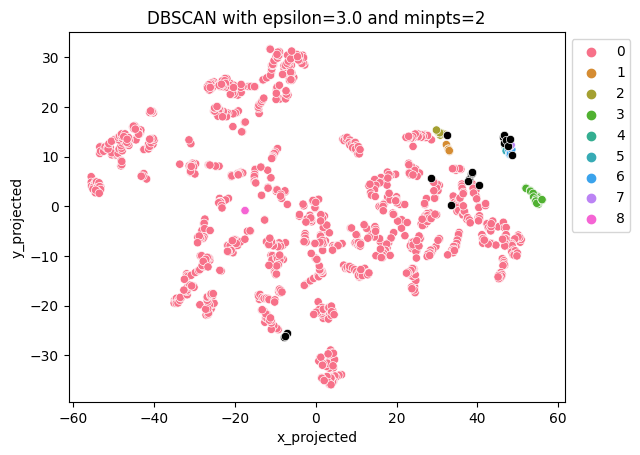

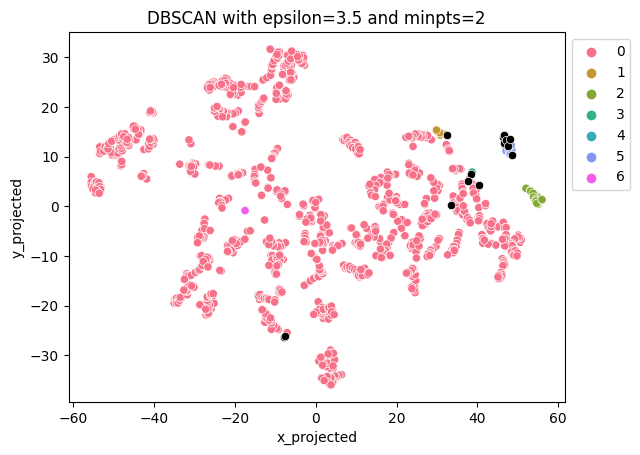

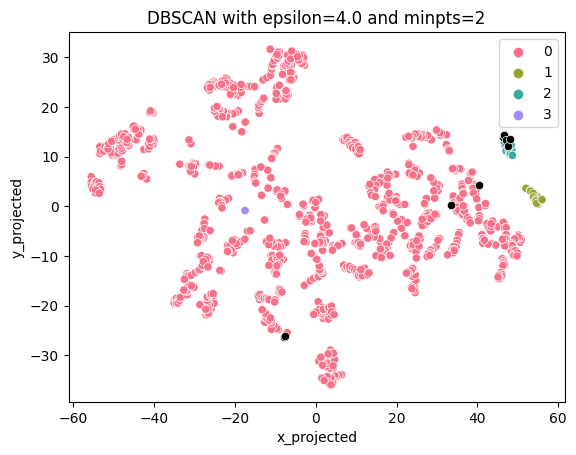

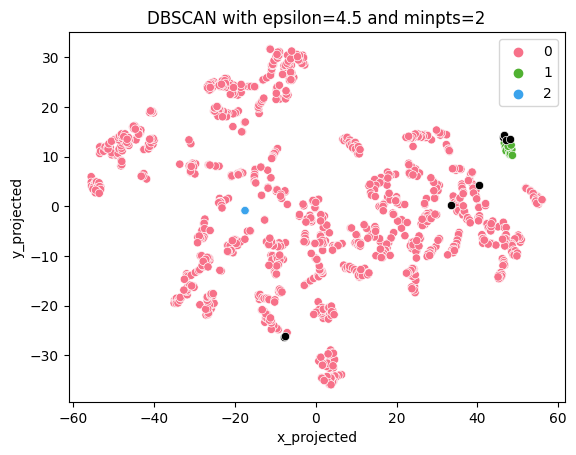

In [64]:
for eps in np.arange(0.5,5,0.5):
    dst = DBSCAN(eps=eps, min_samples=2, metric='euclidean')
    df_combo2['predicted_cluster'] = dst.fit_predict(df2_numerical_scale)
    k=len(df_combo2['predicted_cluster'].value_counts())
    sns.scatterplot(x='x_projected',y='y_projected', hue='predicted_cluster',
                    palette=sns.color_palette("husl", k-1), data=df_combo2[df_combo2['predicted_cluster']>=0])
    sns.scatterplot(x='x_projected',y='y_projected',
                    color='black', data=df_combo2[df_combo2['predicted_cluster']==-1])
    plt.title('DBSCAN with epsilon=%s and minpts=%s' %(eps,2))
    plt.legend(bbox_to_anchor=(1,1))
    plt.show()

In [68]:
dst = DBSCAN(eps=2, min_samples=4, metric='euclidean')
df_combo1['predicted_cluster'] = dst.fit_predict(df1_numerical_scale)

df_combo1['predicted_cluster'].value_counts()

 0    932
-1     73
 1     19
 2     17
 4     13
 5      9
 3      4
 6      4
Name: predicted_cluster, dtype: int64

In [74]:
dst = DBSCAN(eps=2, min_samples=4, metric='euclidean')
df_combo2['predicted_cluster'] = dst.fit_predict(df2_numerical_scale)

df_combo2['predicted_cluster'].value_counts()

 0    986
-1     76
 3     20
 7     13
 4      8
 1      6
 5      5
 2      4
 6      4
Name: predicted_cluster, dtype: int64

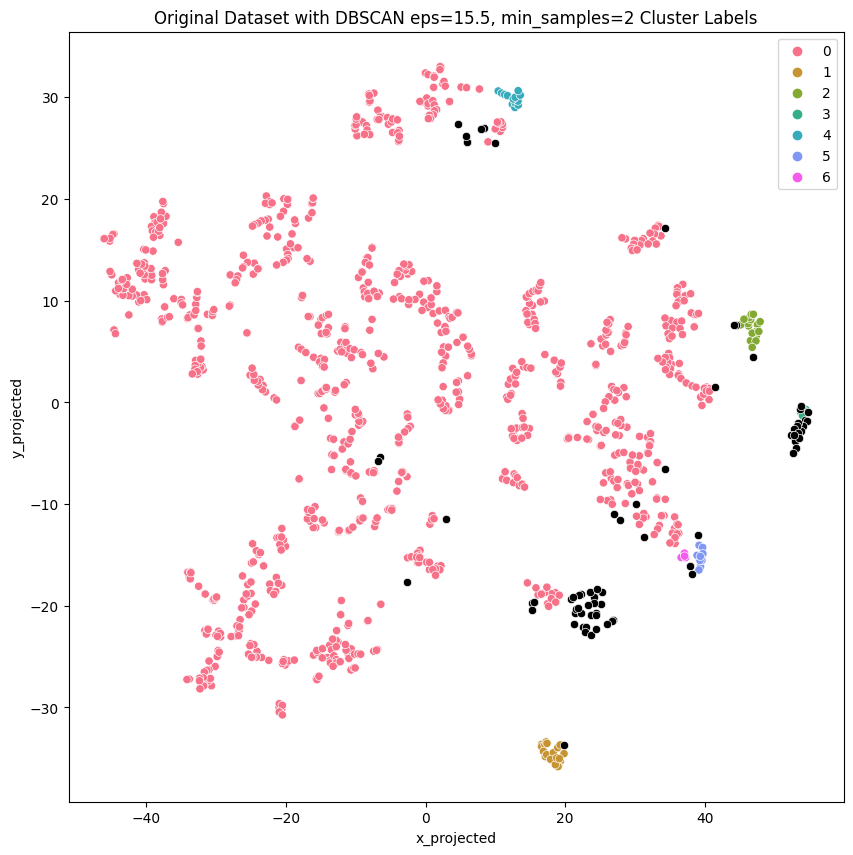

In [71]:
k=len(df_combo1['predicted_cluster'].value_counts())
plt.figure(figsize=(10,10))
sns.scatterplot(x='x_projected',y='y_projected', hue='predicted_cluster',
                palette=sns.color_palette("husl", k-1), data=df_combo1[df_combo1['predicted_cluster']>=0])
sns.scatterplot(x='x_projected',y='y_projected',
                color='black', data=df_combo1[df_combo1['predicted_cluster']==-1])
plt.title("Original Dataset with DBSCAN eps=15.5, min_samples=2 Cluster Labels")
plt.legend(bbox_to_anchor=(1,1))
plt.show()

after 2000s

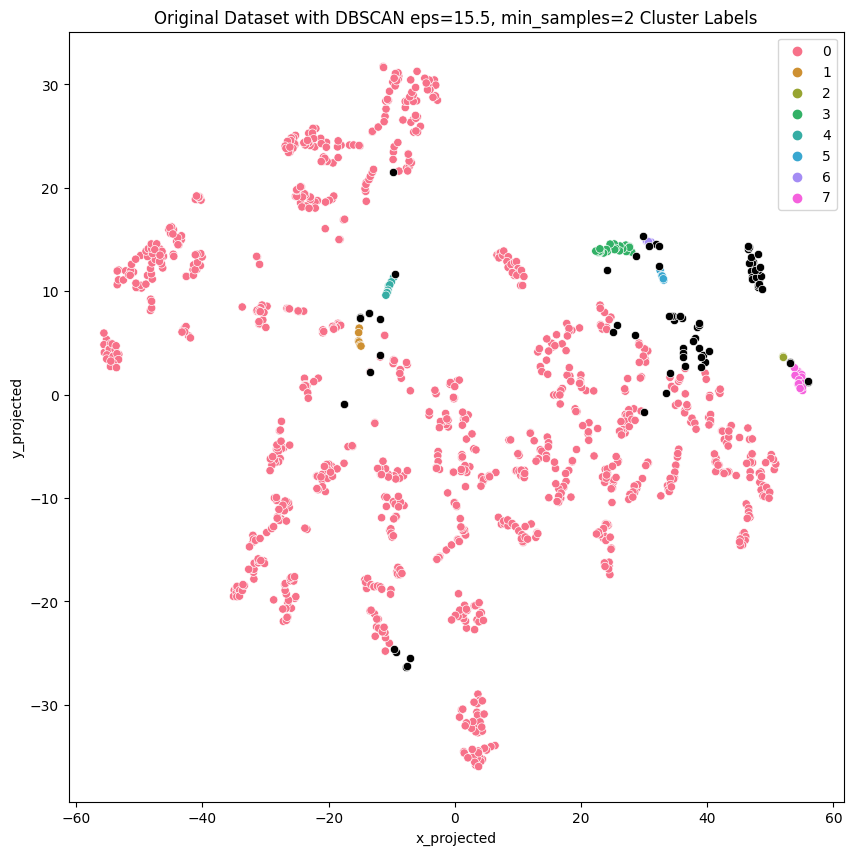

In [75]:
k=len(df_combo2['predicted_cluster'].value_counts())
plt.figure(figsize=(10,10))
sns.scatterplot(x='x_projected',y='y_projected', hue='predicted_cluster',
                palette=sns.color_palette("husl", k-1), data=df_combo2[df_combo2['predicted_cluster']>=0])
sns.scatterplot(x='x_projected',y='y_projected',
                color='black', data=df_combo2[df_combo2['predicted_cluster']==-1])
plt.title("Original Dataset with DBSCAN eps=15.5, min_samples=2 Cluster Labels")
plt.legend(bbox_to_anchor=(1,1))
plt.show()

## 10. Clustering Algorithm #2

k-Means

## 11. Discussion

## 12. Conclusion

## References